# **STOCK MARKET CLUSTERING**

In this project we will be extracting live Stock Market data from yahoo finance. We will find similarities amongst various companies using their stock stock market prices and then cluster them into different clusters using the K-means algorithm.

Note that this is an unsuppervised machine learning problem and will use an unsuppervised machine learning technique with the help of the K-means algorithm.

NB: "pandas_datareader" extract data from variouse internet sources into a Dataframe. Curently the following sources are supported


*   Yahoo! Finance
*   Google Finance
*  St. Louis FED (FRED)
* Kenneth French's data library
* World Bank
* Google Analytics



In [1]:
!pip install pandas_datareader

In [2]:
!pip install plotly

In [3]:
from pandas_datareader import data
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import datetime
import warnings
warnings.simplefilter('ignore')

In [4]:
companies_dict = {
    'Amazon':'AMZN',
    'Apple':'AAPL',
    'Walgreen':'WBA',
    'Northrop Grumman':'NOC',
    'Boeing':'BA',
    'Lockheed Martin':'LMT',
    'McDonalds':'MCD',
    'Intel':'INTC',
    'Rayheon':'RTX',
    'IBM':'IBM',
    'Texas Instruments':'TXN',
    'MasterCard':'MA',
    'Microsoft':'MSFT',
    'General Electrics':'GE',
    'Tesla':"TSLA",
    'American Express':'AXP',
    'Pepsi':'PEP',
    'Coca Cola':'KO',
    'Johnson & Johnson':'JNJ',
    'Toyota':'TM',
    'Honda':'HMC',
    'L3Harris':'LHX',
    'General Dynamics':"GD",
    'Exxon':'XOM',
    'Chevron':'CVX',
    'Valero Energy':'VLO',
    'Ford':'F',
    'Bank of America':'BAC'}

In [5]:
!pip install yfinance

In [6]:
from pandas_datareader import data as pdr
import yfinance as yf
yf.pdr_override()
from datetime import datetime
startdate = datetime(2018,7,1)
enddate = datetime(2023,7,1)
df = pdr.get_data_yahoo(list(companies_dict.values()), start=startdate, end=enddate)

[*********************100%***********************]  28 of 28 completed


In [7]:
df

Adj Close                                                 \
                  AAPL        AMZN         AXP          BA        BAC   
Date                                                                    
2018-07-02   44.720825   85.689003   92.207932  323.468445  25.186296   
2018-07-03   43.941948   84.697998   91.127510  320.436646  24.740993   
2018-07-05   44.295559   84.986504   92.099640  320.677246  24.865679   
2018-07-06   44.909576   85.531502   92.090286  322.082520  24.963642   
2018-07-09   45.533150   86.950996   93.389572  329.089325  25.872061   
...                ...         ...         ...         ...        ...   
2023-06-26  185.270004  127.330002  167.110001  205.580002  28.090000   
2023-06-27  188.059998  129.179993  168.190002  209.429993  28.240000   
2023-06-28  189.250000  129.039993  169.779999  210.720001  28.070000   
2023-06-29  189.589996  127.900002  172.080002  211.830002  28.660000   
2023-06-30  193.970001  130.360001  174.199997  211.160004  28.690001   

                                                                      ...  \
                   CVX          F          GD          GE        HMC  ...   
Date                                                                  ...   
2018-07-02   99.789871   8.876298  166.059647   78.045280  25.641830  ...   
2018-07-03  100.175392   8.788338  168.115784   78.045280  25.553415  ...   
2018-07-05   99.573044   8.836315  168.062363   78.395523  25.747938  ...   
2018-07-06   99.701538   8.844314  168.187042   80.847191  25.809832  ...   
2018-07-09  101.187347   8.956264  170.591721   81.430931  26.039722  ...   
...                ...        ...         ...         ...        ...  ...   
2023-06-26  154.009995  14.110000  212.089996  104.449997  29.959999  ...   
2023-06-27  153.529999  14.410000  212.059998  104.919998  30.219999  ...   
2023-06-28  154.919998  14.790000  211.000000  107.050003  30.549999  ...   
2023-06-29  156.240005  14.950000  214.309998  107.739998  30.370001  ...   
2023-06-30  157.350006  15.130000  215.149994  109.849998  30.309999  ...   

              Volume                                                        \
                MSFT     NOC      PEP      RTX      TM       TSLA      TXN   
Date                                                                         
2018-07-02  19564500  636700  4711900  6706692  101500  281397000  3392500   
2018-07-03  14670300  336000  3769100  3918474   96500  184239000  2201500   
2018-07-05  18977400  677800  4870400  5456944  120800  262146000  4097700   
2018-07-06  19234600  689600  4387300  3665346   84300  132982500  3419700   
2018-07-09  18212000  864300  7866400  5400534   69500  113952000  3658000   
...              ...     ...      ...      ...     ...        ...      ...   
2023-06-26  21520600  744200  3706100  3993600  305400  179990600  4899600   
2023-06-27  24354100  535200  5763000  4048200  283000  164968200  6257800   
2023-06-28  20259500  618800  5193900  4014900  555200  159770800  3425300   
2023-06-29  16997000  531200  5770400  4071400  347700  131283400  3704700   
2023-06-30  26823800  765300  7635100  4381500  311100  112267600  6004400   

                                         
                VLO       WBA       XOM  
Date                                     
2018-07-02  3748500  11309700   9998300  
2018-07-03  2078100   5602300   7197300  
2018-07-05  3400600  12473000   9035700  
2018-07-06  2461300   9741000   7637100  
2018-07-09  2726500   7513000   7158600  
...             ...       ...       ...  
2023-06-26  3152500  11511400  14283400  
2023-06-27  3740500  46928300  13227500  
2023-06-28  2506100  18375200  13084100  
2023-06-29  2272800  15715400  11364400  
2023-06-30  2975600  12868000  13542700  

[1258 rows x 168 columns]

In [8]:
df.isnull().sum()

Adj Close  AAPL    0
           AMZN    0
           AXP     0
           BA      0
           BAC     0
                  ..
Volume     TSLA    0
           TXN     0
           VLO     0
           WBA     0
           XOM     0
Length: 168, dtype: int64

In [9]:
df.isnull().sum().sum()

0

In [10]:
stock_open=np.array(df['Open']).T
stock_close=np.array(df['Close']).T

In [11]:
## Movements is the difference between opening and closing prices of a particular day, Positive movement suggests go long on stock(buy) and negative movement suggests to short the stock(sell)
movements=stock_close-stock_open

In [12]:
sum_of_movement=np.sum(movements,1) ## Sum of difference of closing and opening prices of all days

In [13]:
for i in range(len(companies_dict)):
  print("Company:{}, Change:{}".format(df['High'].columns[i],sum_of_movement[i]))

Company:AAPL, Change:144.8921890258789
Company:AMZN, Change:-68.8706283569336
Company:AXP, Change:-22.43012237548828
Company:BA, Change:-216.21036529541016
Company:BAC, Change:-6.840003967285156
Company:CVX, Change:-14.779922485351562
Company:F, Change:-5.260012626647949
Company:GD, Change:-51.030067443847656
Company:GE, Change:-13.179603576660156
Company:HMC, Change:-8.25
Company:IBM, Change:21.567123413085938
Company:INTC, Change:9.549936294555664
Company:JNJ, Change:14.059921264648438
Company:KO, Change:-14.350013732910156
Company:LHX, Change:-30.65033721923828
Company:LMT, Change:12.8704833984375
Company:MA, Change:46.54084777832031
Company:MCD, Change:55.15010070800781
Company:MSFT, Change:112.98995208740234
Company:NOC, Change:112.74041748046875
Company:PEP, Change:5.620109558105469
Company:RTX, Change:-15.761466979980469
Company:TM, Change:-70.8299789428711
Company:TSLA, Change:-45.77805709838867
Company:TXN, Change:54.31993865966797
Company:VLO, Change:-50.71995544433594
Compan

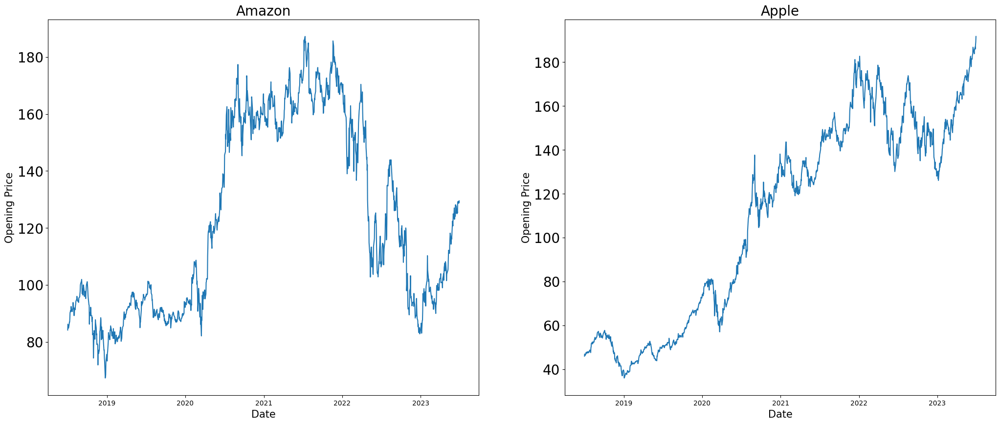

In [14]:
plt.figure(figsize=(25,10))

plt.subplot(1,2,1)
plt.title("Amazon", fontsize=20)
plt.xticks(fontsize=10)
plt.yticks(fontsize=20)
plt.xlabel('Date',fontsize=15)
plt.ylabel('Opening Price',fontsize=15)
plt.plot(df['Open']['AMZN'])

plt.subplot(1,2,2)
plt.title("Apple", fontsize=20)
plt.xticks(fontsize=10)
plt.yticks(fontsize=20)
plt.xlabel('Date',fontsize=15)
plt.ylabel('Opening Price',fontsize=15)
plt.plot(df['Open']['AAPL'])



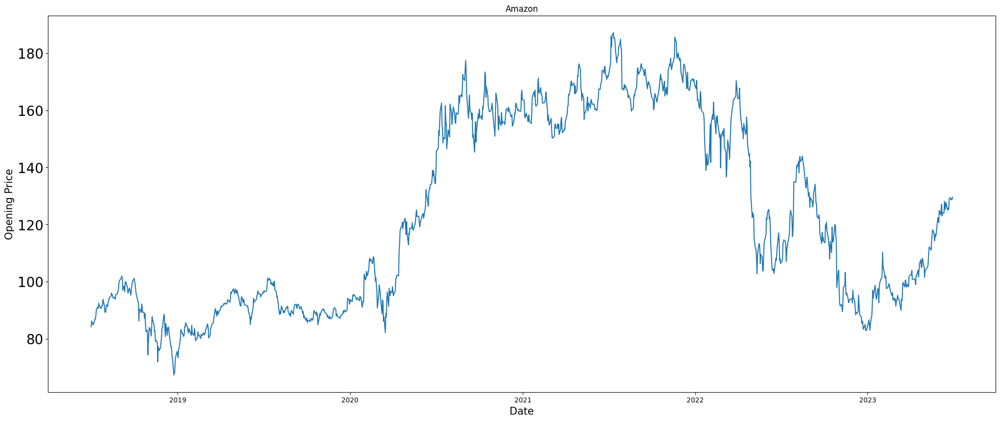

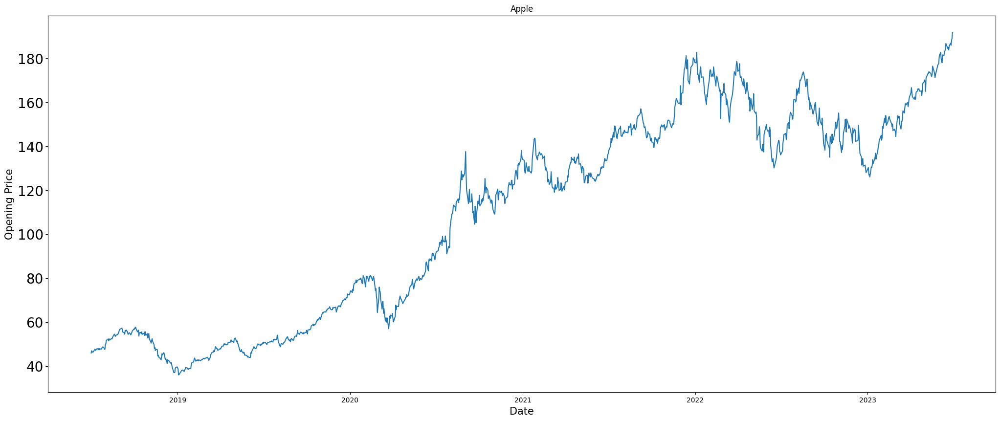

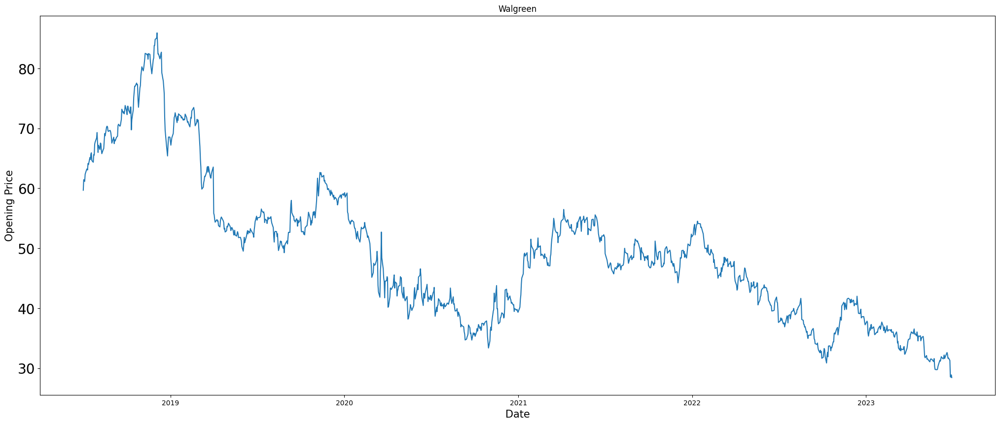

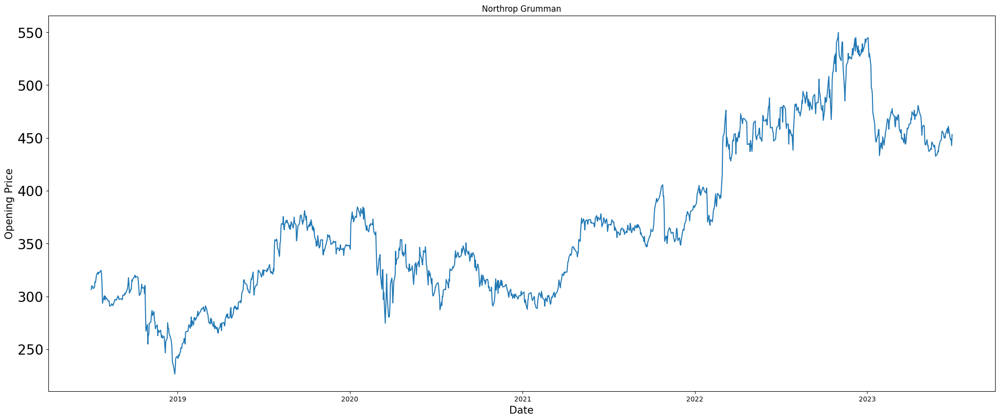

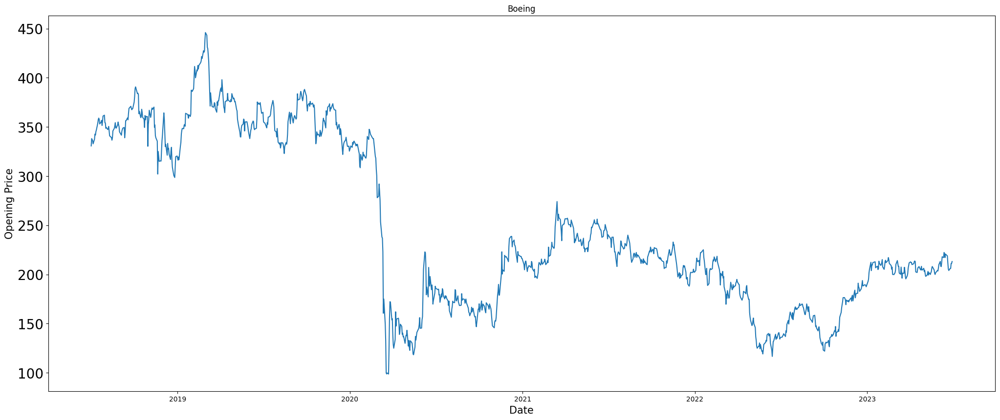

...

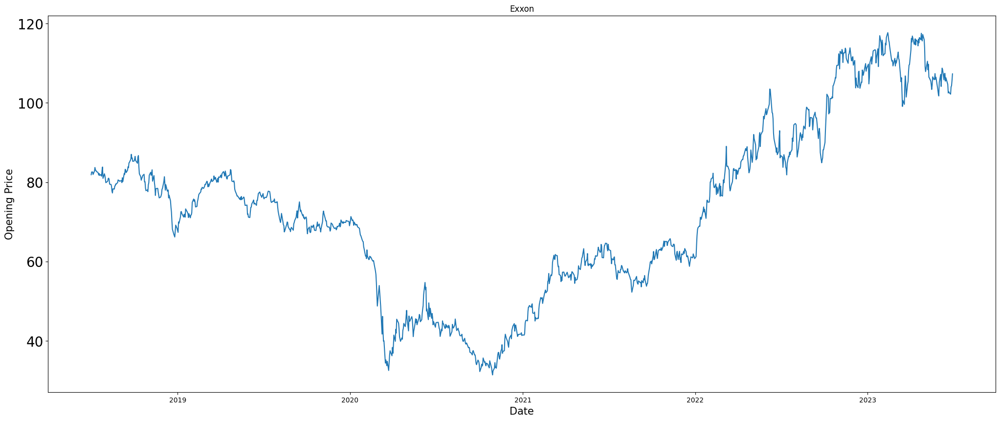

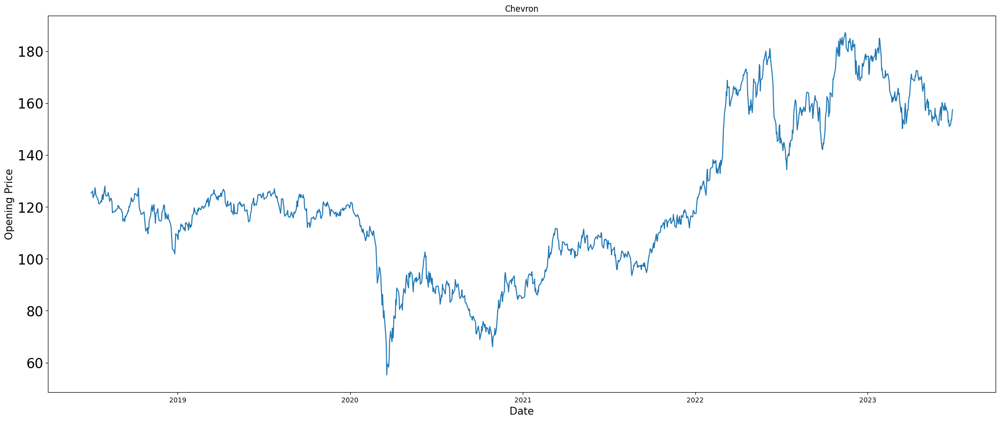

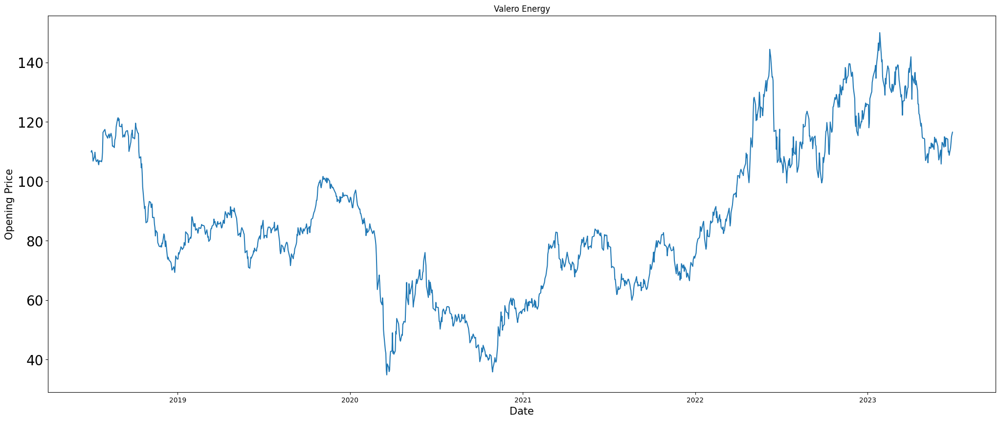

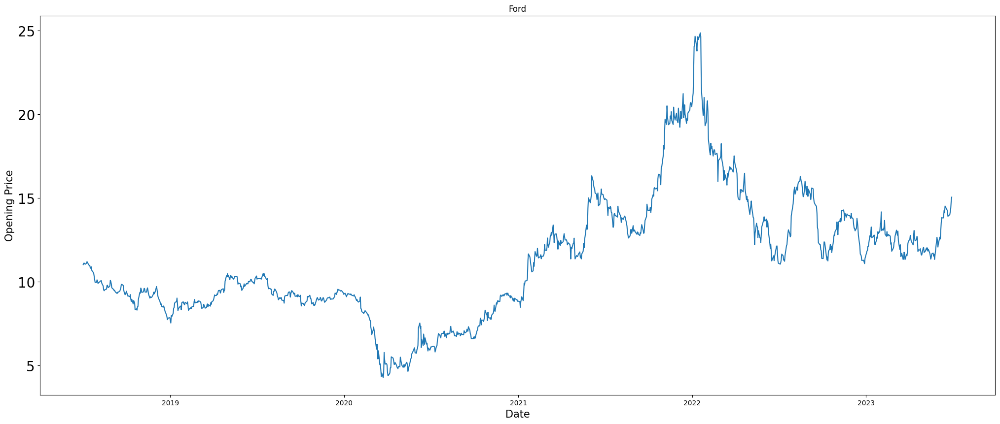

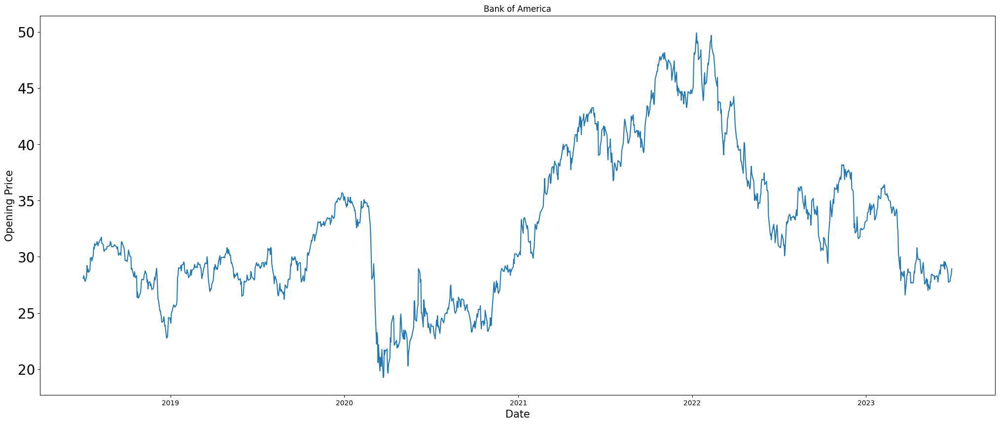

In [15]:
## Seeing the trends for each company
for i,j in companies_dict.items():
  plt.figure(figsize=(25,10))
  plt.title(i)
  plt.xticks(fontsize=10)
  plt.yticks(fontsize=20)
  plt.xlabel('Date',fontsize=15)
  plt.ylabel('Opening Price',fontsize=15)
  plt.plot(df['Open'][j])

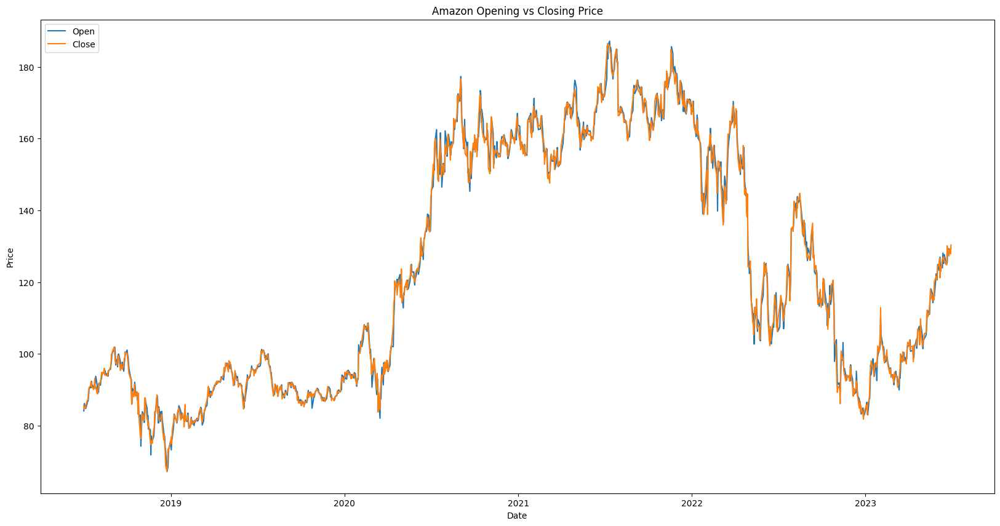

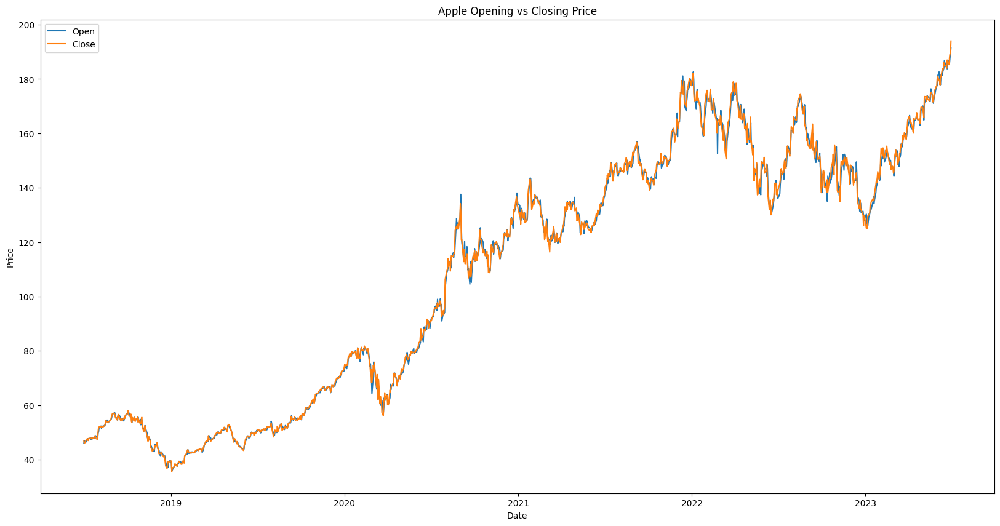

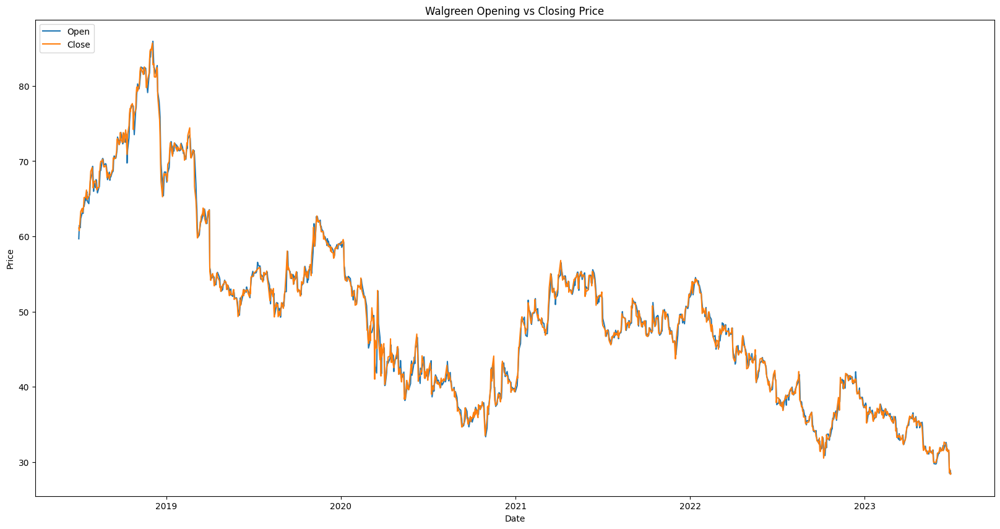

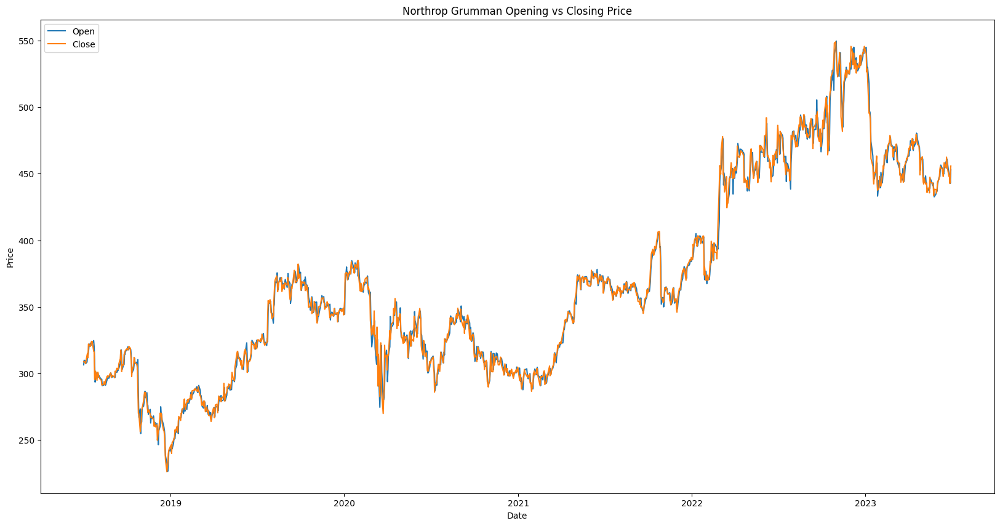

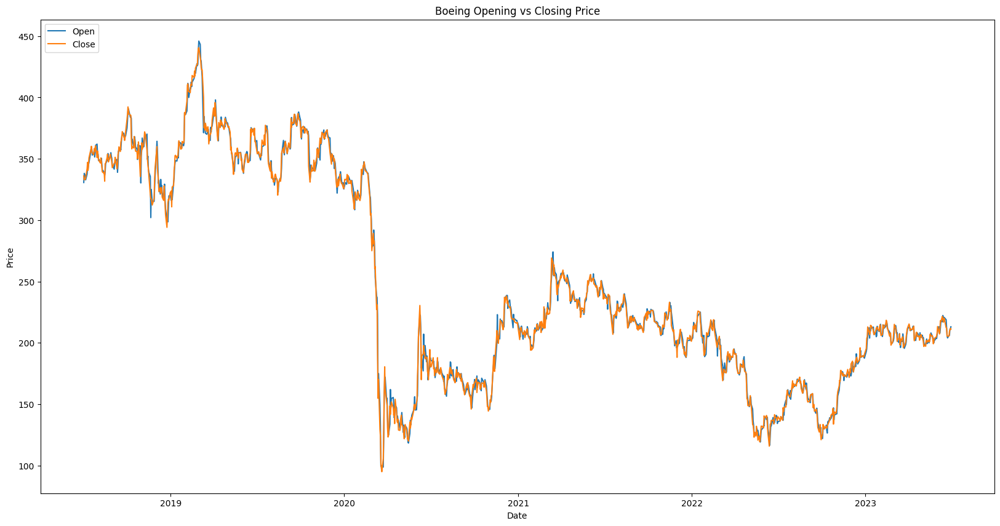

...

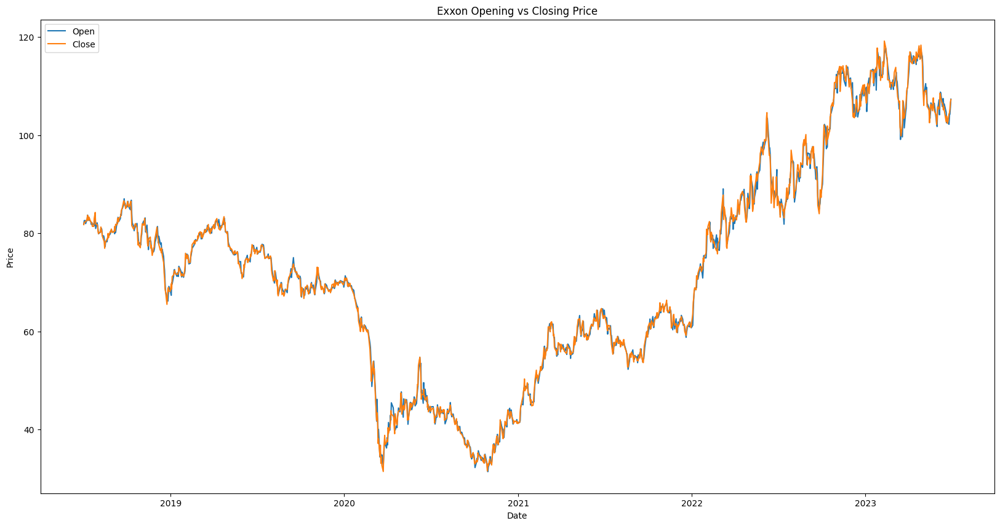

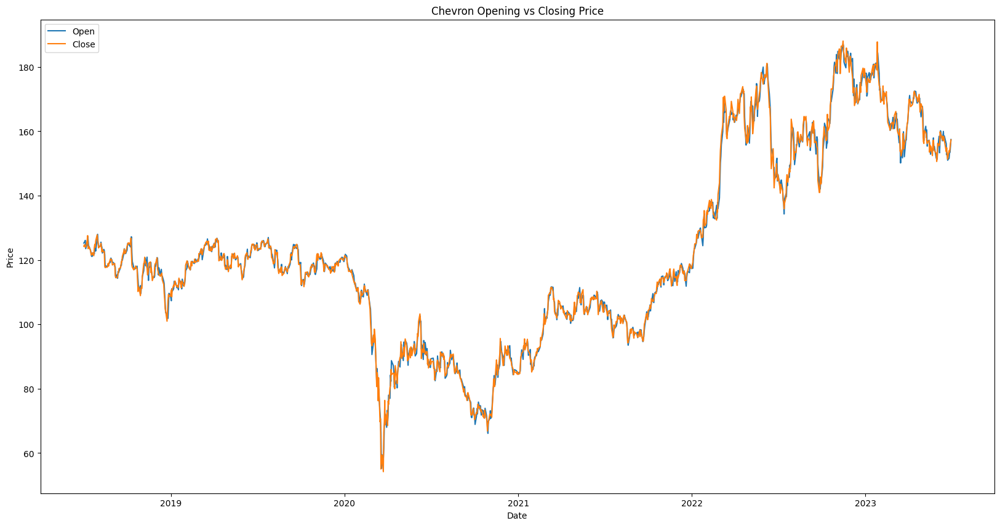

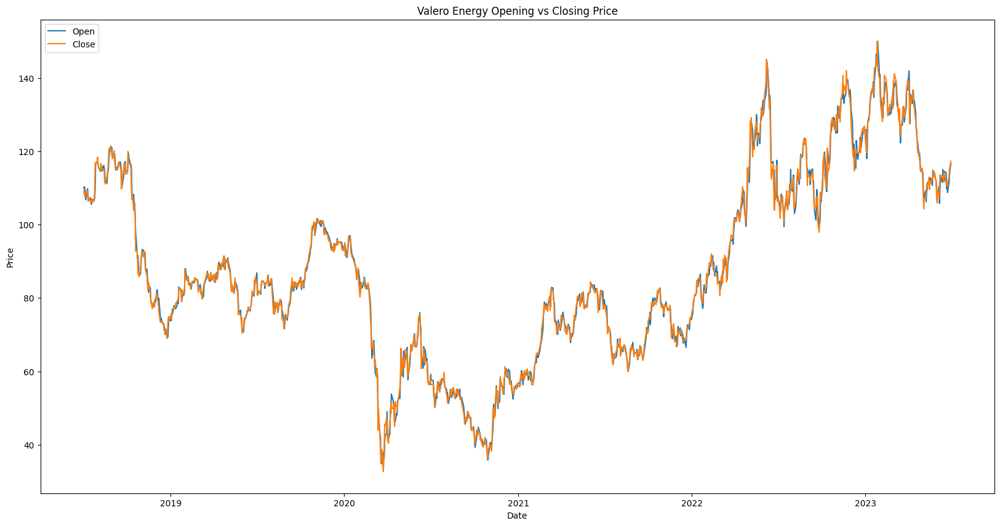

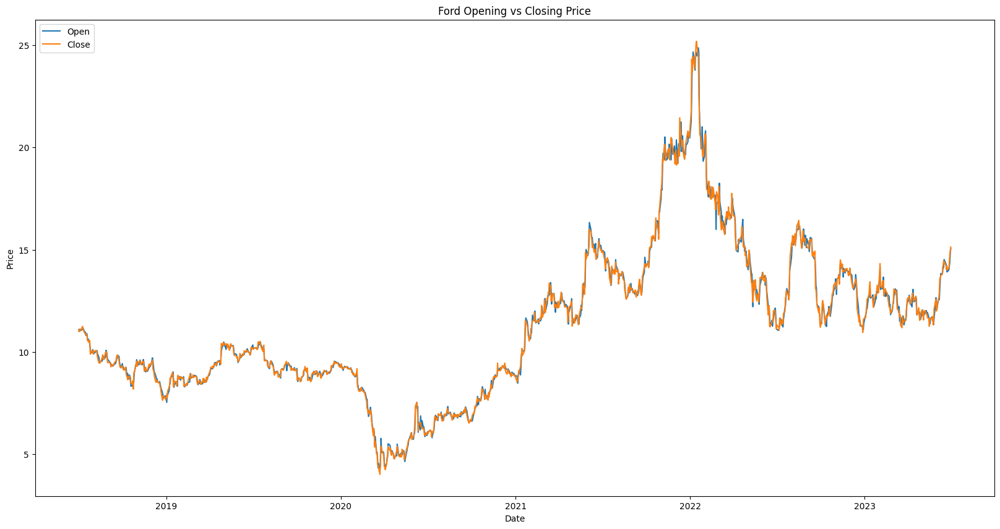

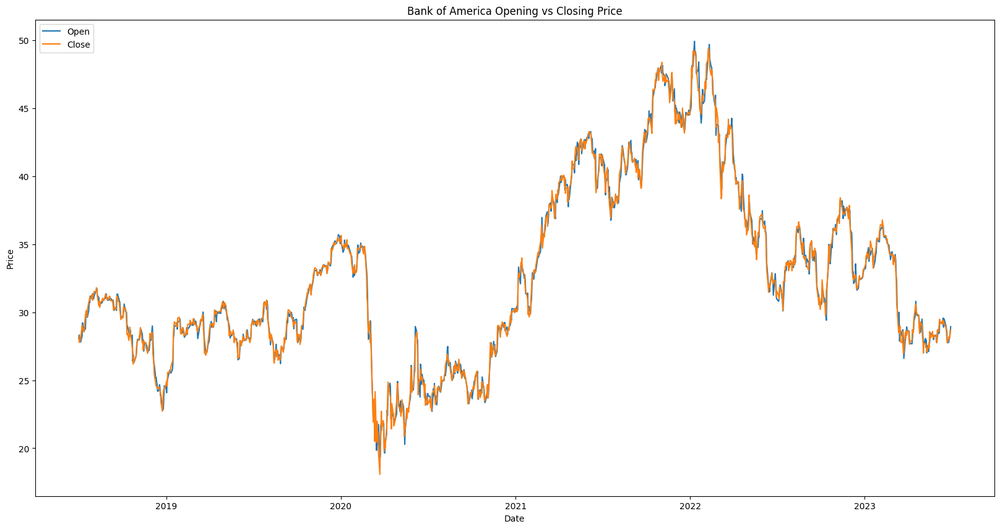

In [16]:
for i,j in companies_dict.items():
  plt.figure(figsize=(20,10))
  plt.title(i + " Opening vs Closing Price")
  plt.xlabel('Date')
  plt.ylabel('Price')
  plt.plot(df['Open'][j], label='Open')
  plt.plot(df['Close'][j], label='Close')
  plt.legend(loc='upper left')

In [17]:
movements_1=df['Close']-df['Open']

In [18]:
movements_1

,AAPL,AMZN,AXP,BA,BAC,CVX,F,GD,GE,HMC,...,MSFT,NOC,PEP,RTX,TM,TSLA,TXN,VLO,WBA,XOM
Date,,,,,,,,,,,,,,,,,,,,,
2018-07-02,0.839996,1.554001,1.599998,5.389984,0.200001,-1.029999,0.080000,2.179993,-0.660538,0.139999,...,1.910004,2.429993,0.830002,0.730019,0.410004,-1.666668,1.299995,-0.669998,1.450001,-0.129997
2018-07-03,-0.967499,-1.500000,-1.470001,-5.250000,-0.549999,-0.729996,-0.110001,1.240005,0.120102,-0.170000,...,-1.430000,-1.070007,0.220001,-0.597862,-0.930000,-1.392666,-1.699997,-2.190002,-0.690002,-0.340004
2018-07-05,0.035000,-0.282494,0.180000,-2.970001,-0.030001,-2.129997,-0.050000,-0.710007,0.300247,0.070002,...,0.260002,-1.290009,0.639999,-0.610443,0.690002,-0.306667,1.670006,-1.639999,1.230000,-0.279999
2018-07-06,0.637501,0.731499,0.059998,1.800018,0.220001,0.620003,0.020000,0.269989,2.882362,-0.059999,...,1.270004,-0.010010,0.070000,0.346130,0.130005,0.263332,1.150002,1.050003,0.939999,0.370003
2018-07-09,0.270000,0.748497,0.650002,4.420013,0.820000,0.989998,0.099999,2.329987,0.060051,0.120001,...,0.199997,5.210022,-1.369995,0.421654,0.470001,0.434666,-1.310005,0.969994,0.610001,0.090004
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-06-26,-1.559998,-2.000000,-1.419998,-0.529999,0.290001,2.389999,0.099999,0.580002,0.919998,-0.210001,...,-5.119995,-1.570007,-1.270004,0.570000,-0.830002,-9.020004,0.259995,1.619995,0.290001,2.090004
2023-06-27,2.169998,0.549988,1.839996,3.279999,0.139999,0.029999,0.220000,-0.190002,0.290001,0.260000,...,2.710022,0.200012,1.550003,0.180000,1.839996,6.970001,6.479996,2.139999,0.080000,0.500000
2023-06-28,1.320007,0.099991,2.520004,-0.490005,-0.180000,1.479996,0.400000,-1.289993,1.760002,0.099998,...,1.190002,-6.130005,-2.550003,-0.519997,0.990005,6.539993,0.310013,0.630005,0.570000,1.090004


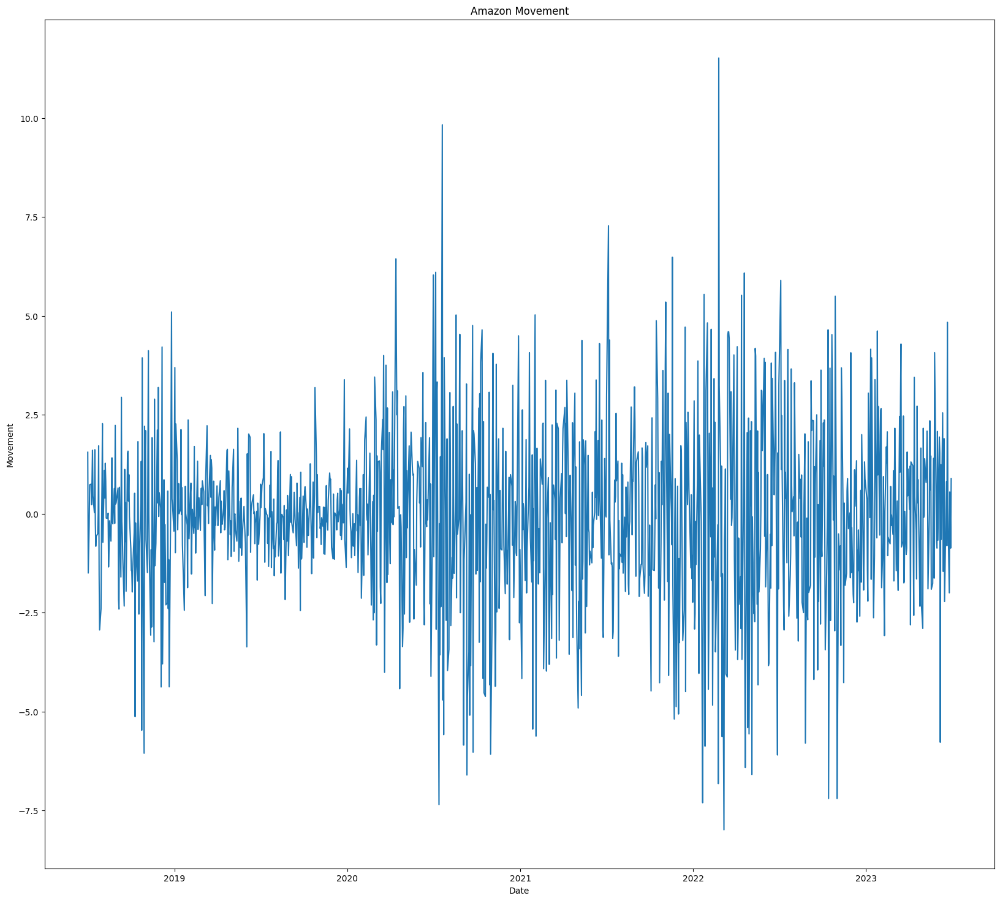

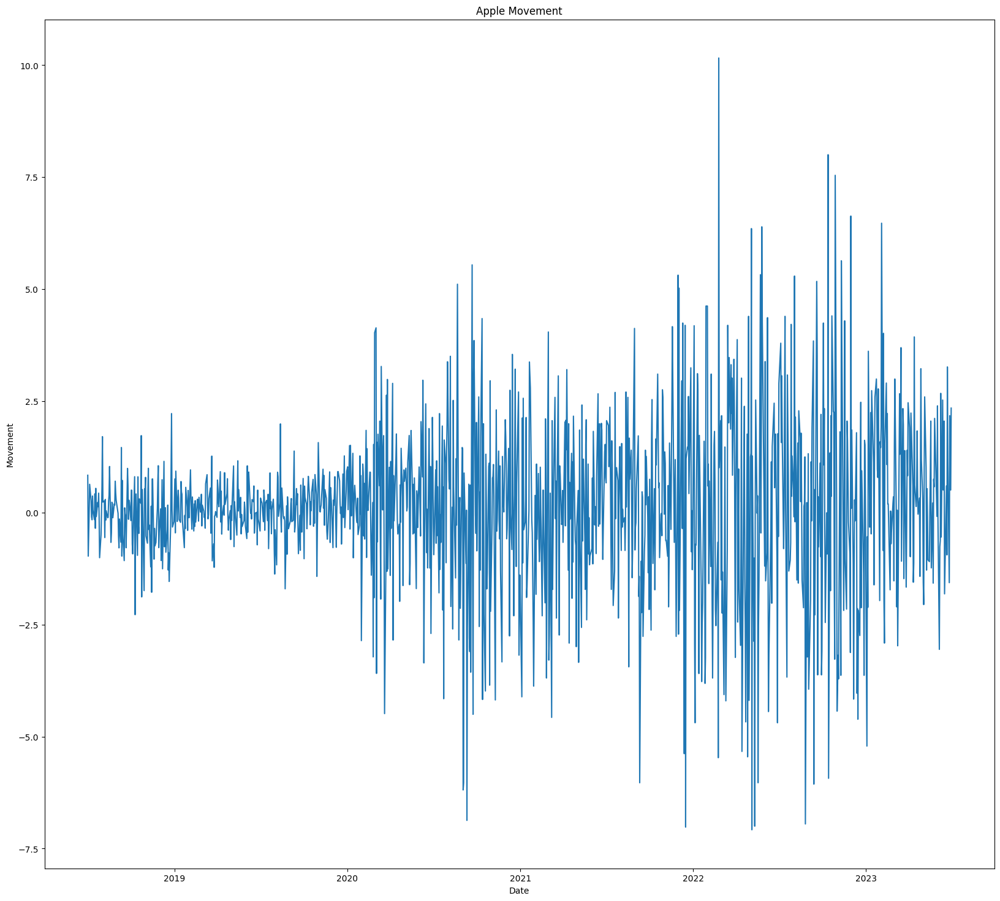

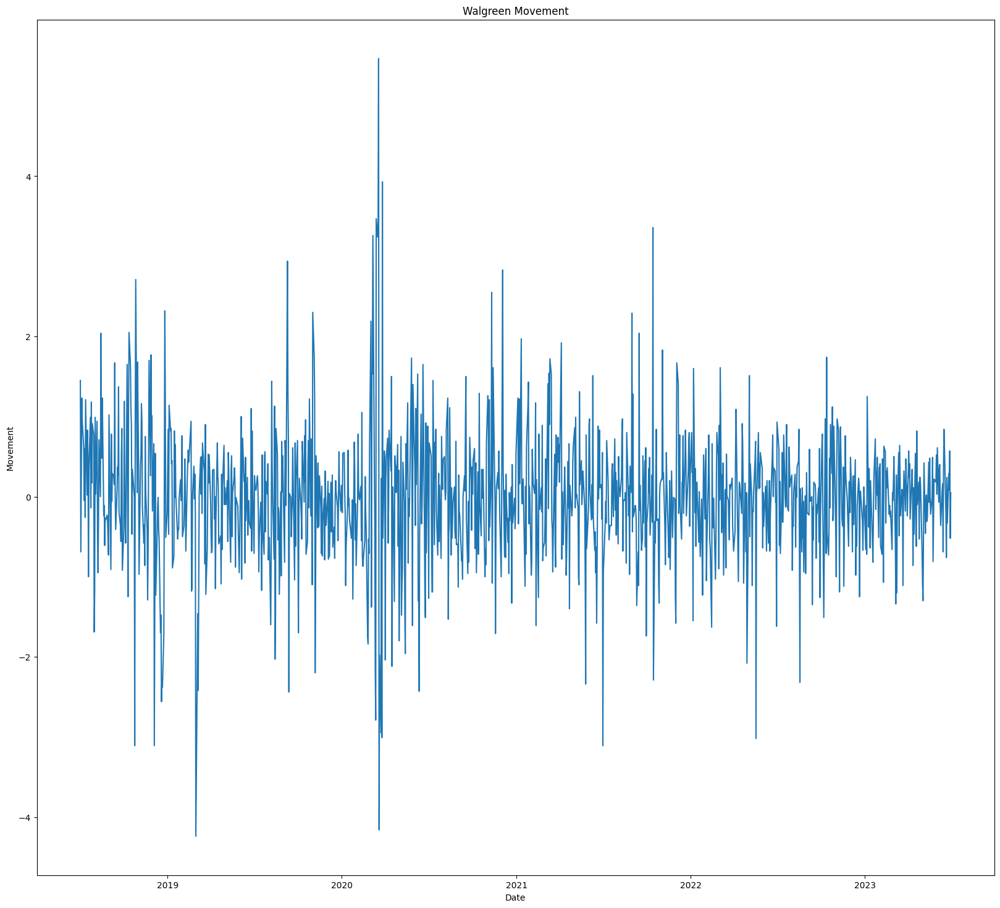

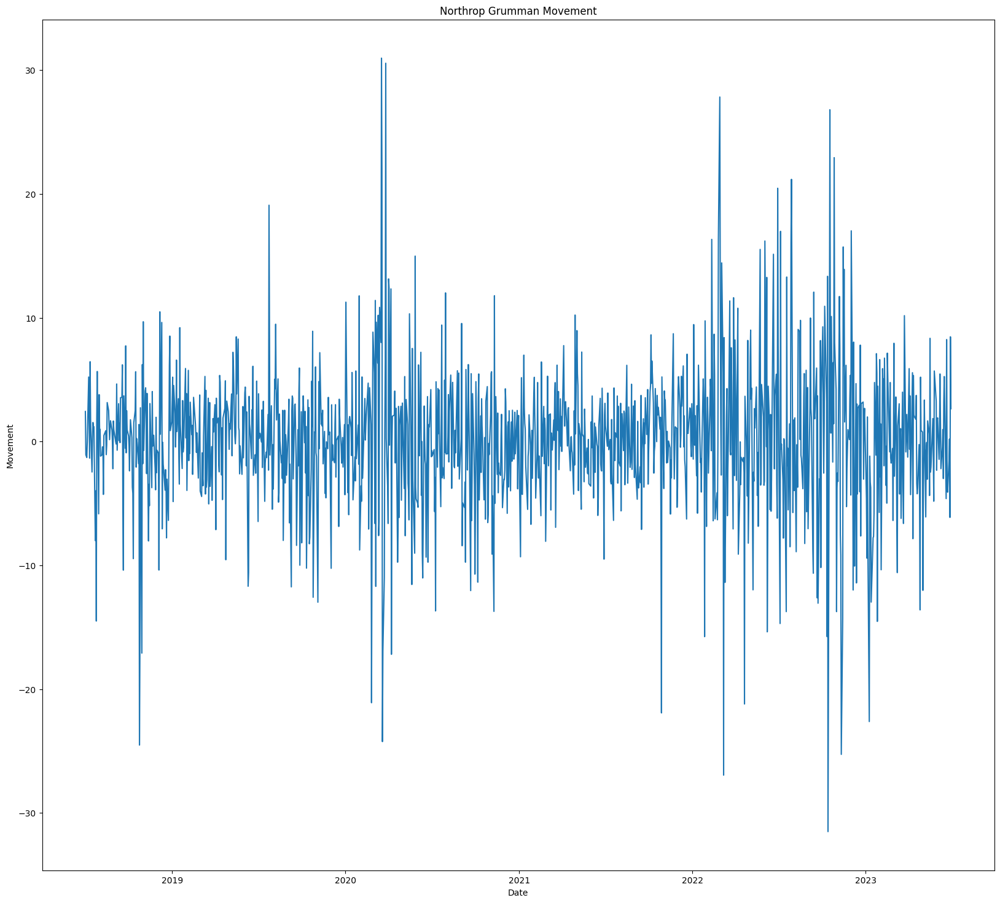

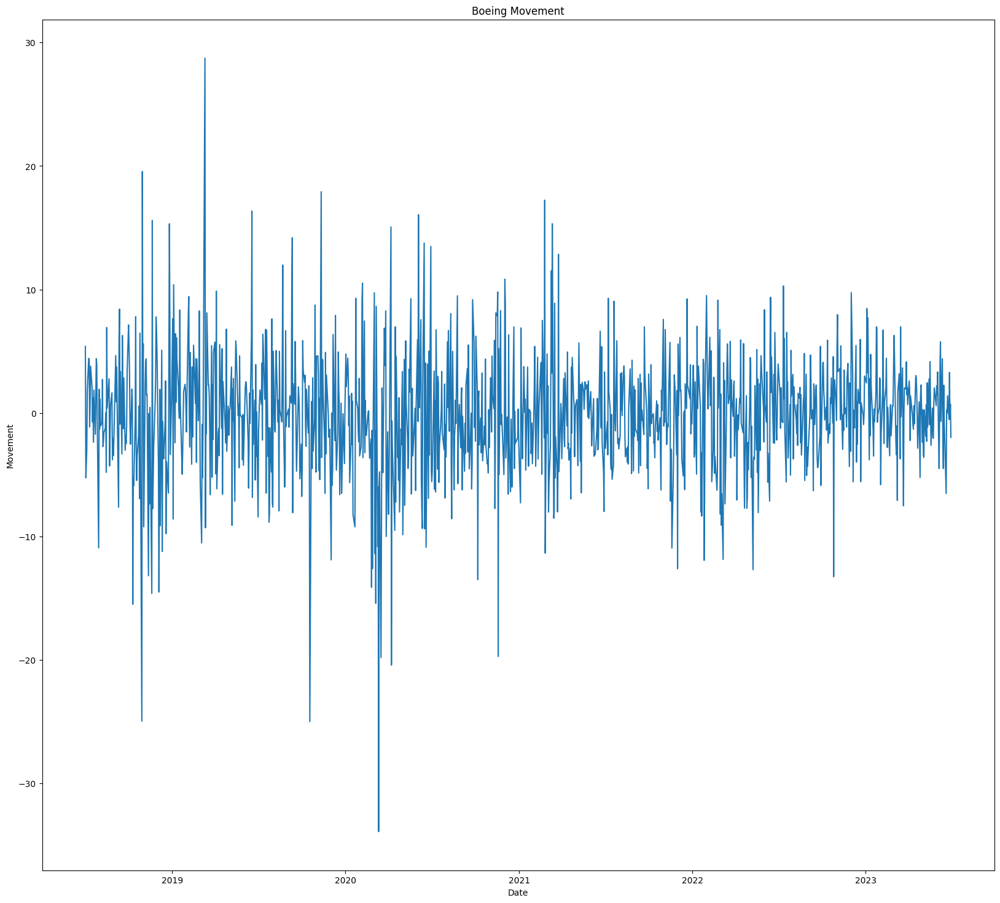

...

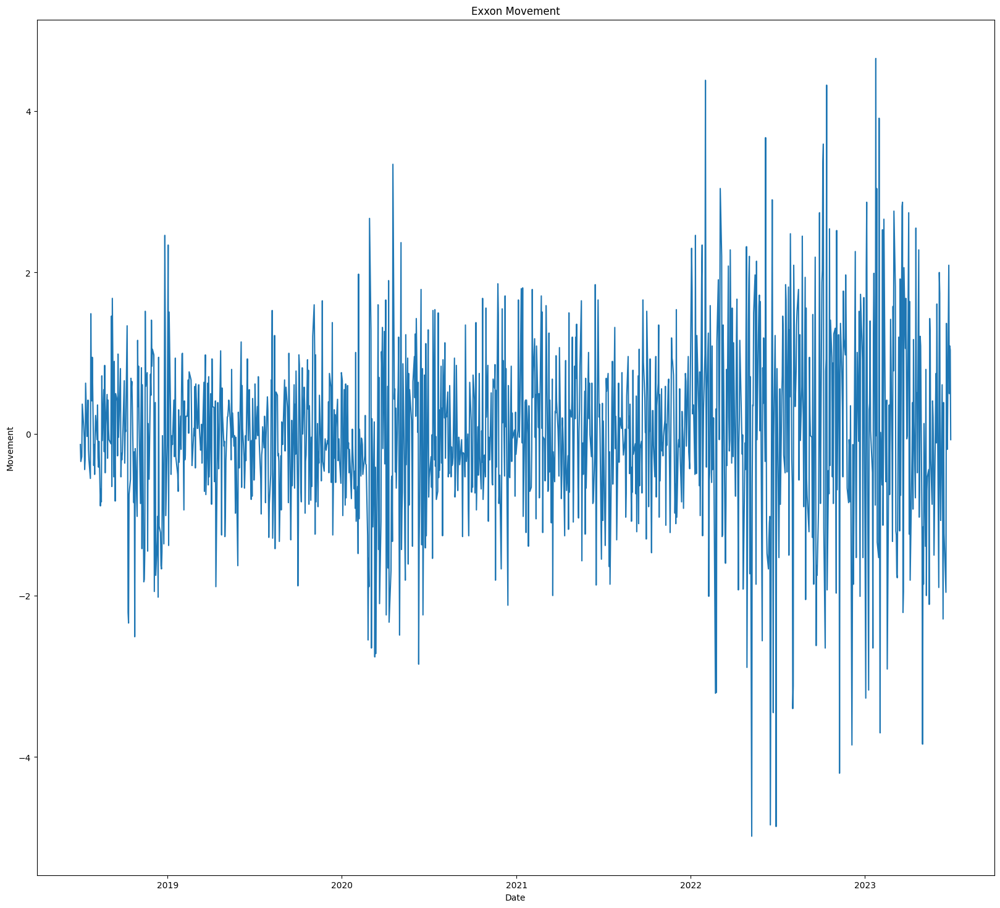

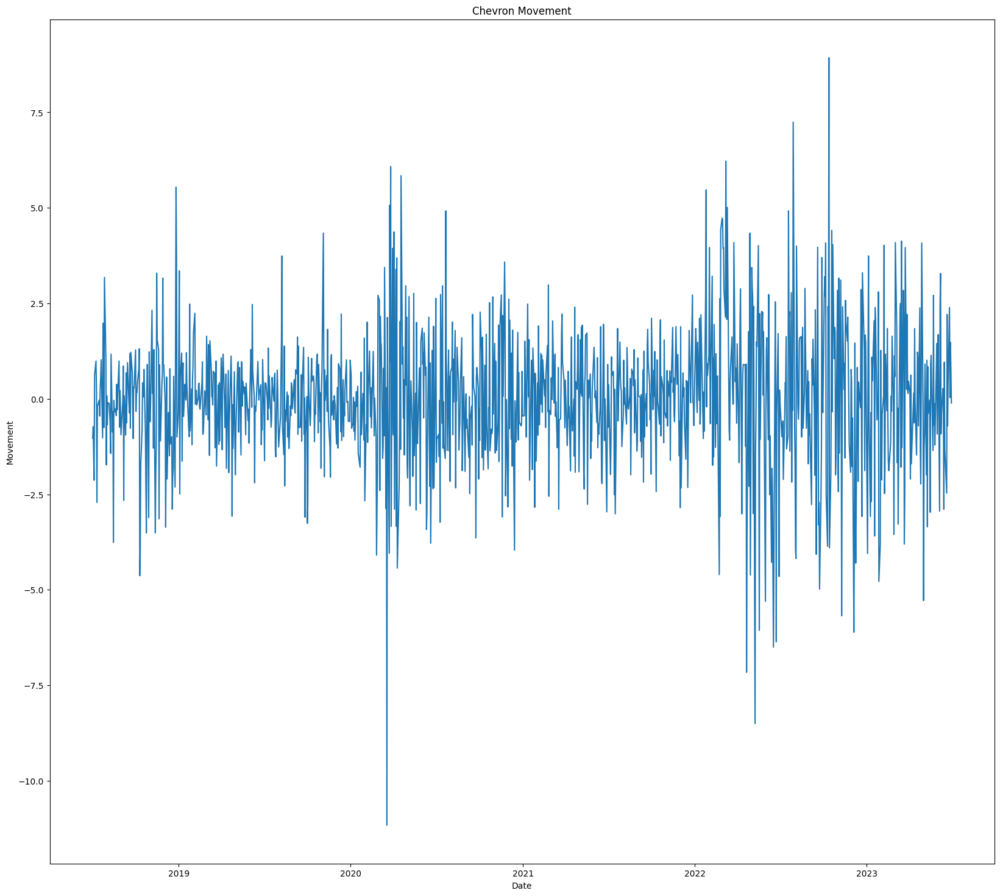

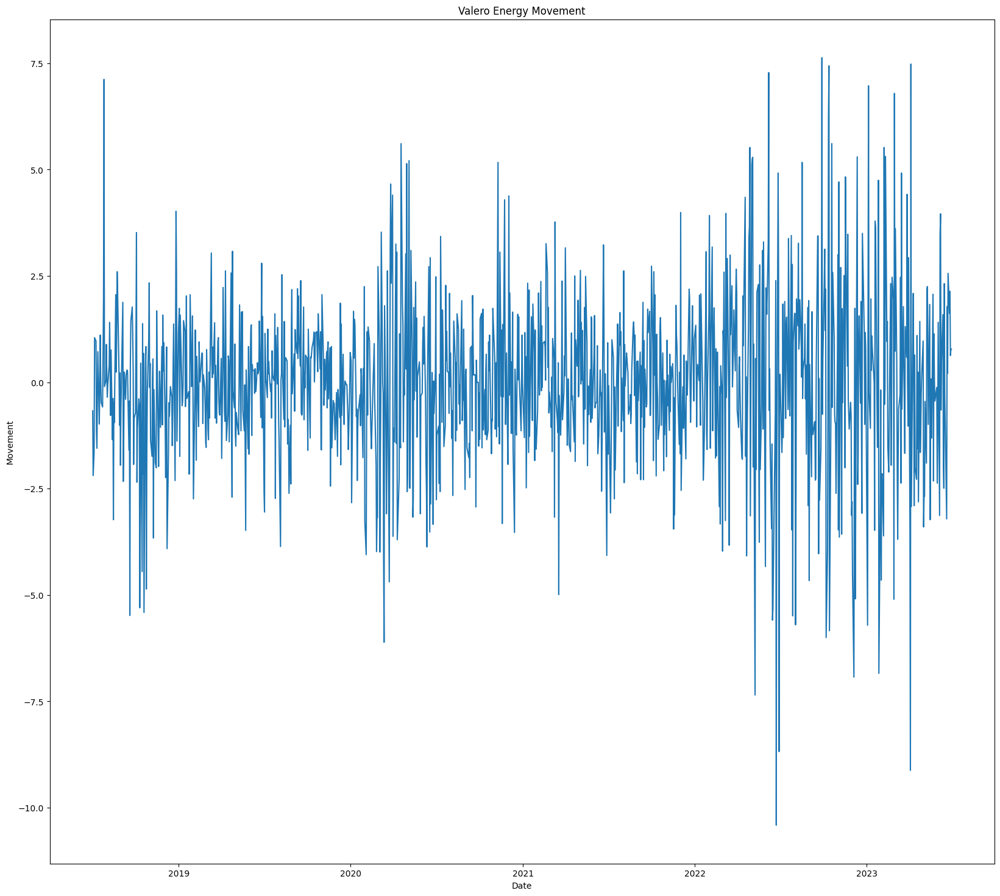

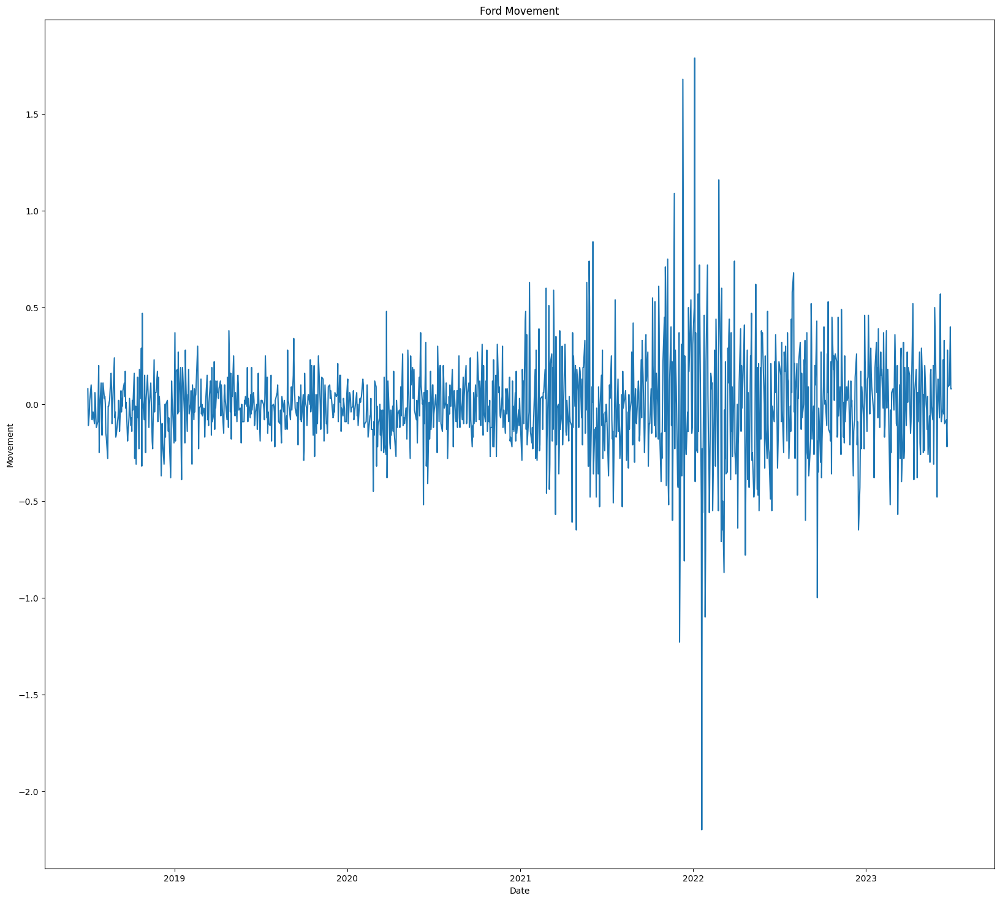

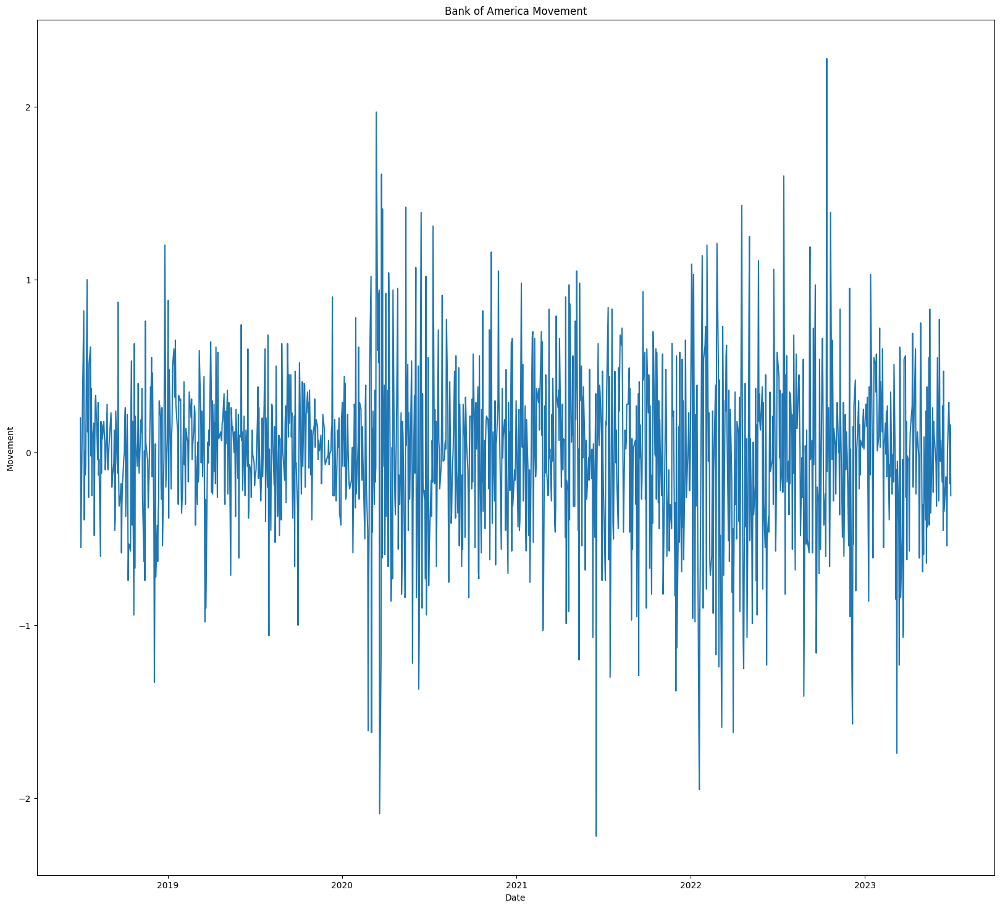

In [19]:
for i,j in companies_dict.items():
  plt.figure(figsize=(20,18))
  plt.title(i + " Movement")
  plt.xlabel('Date')
  plt.ylabel('Movement')
  plt.plot(movements_1[j])

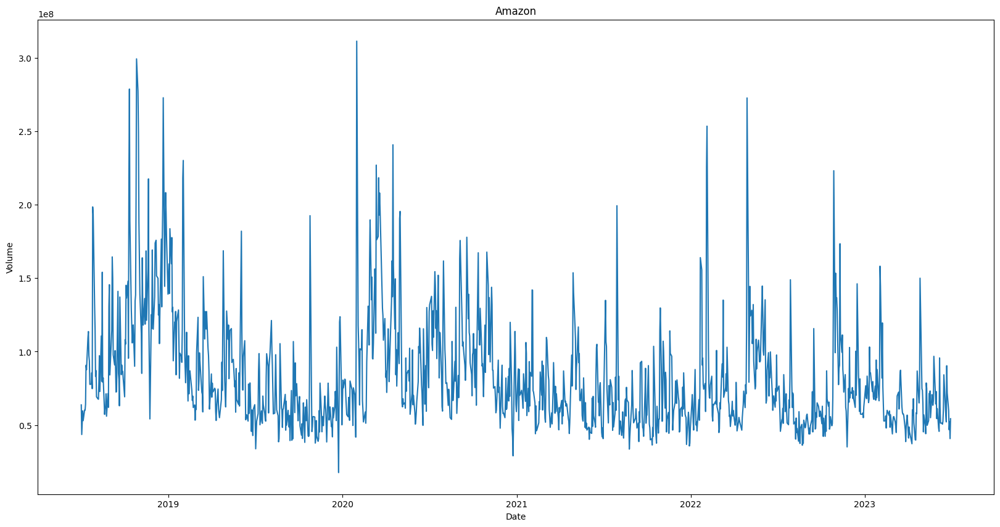

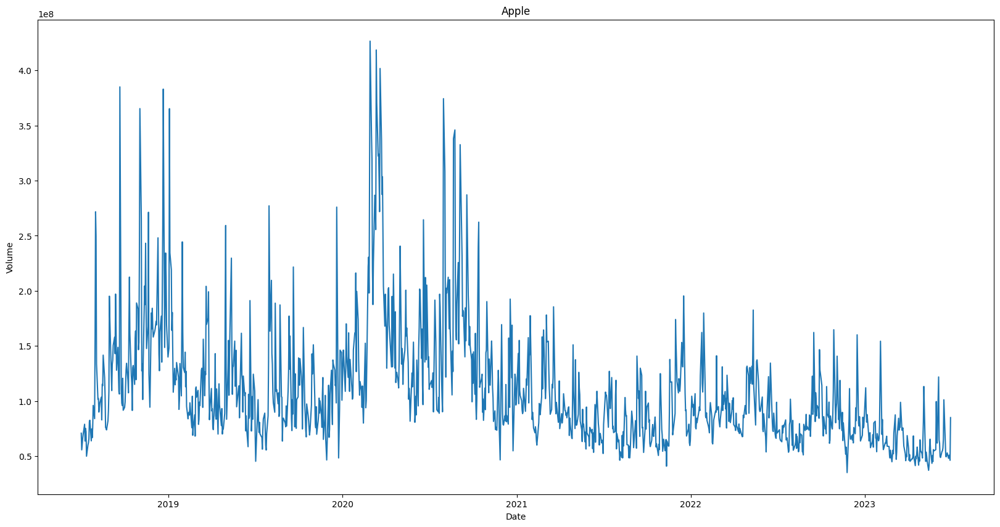

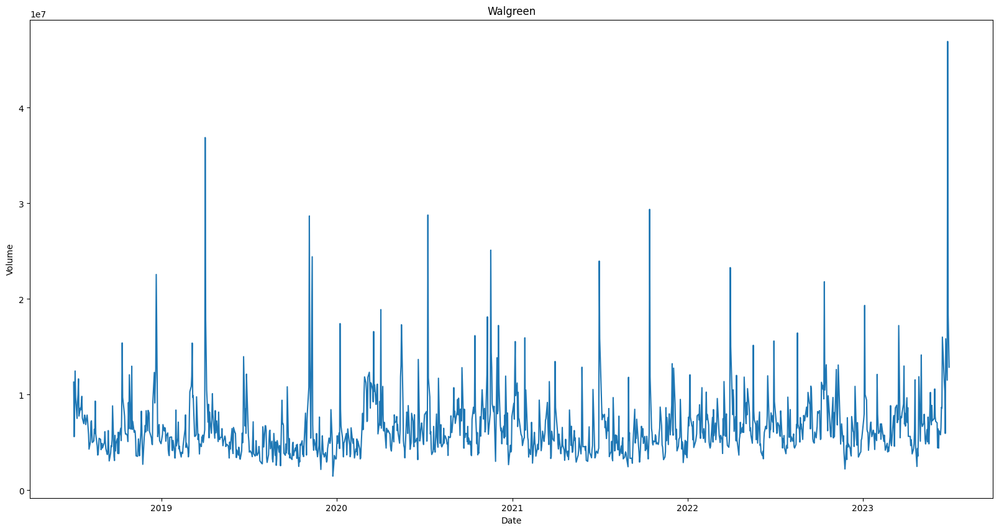

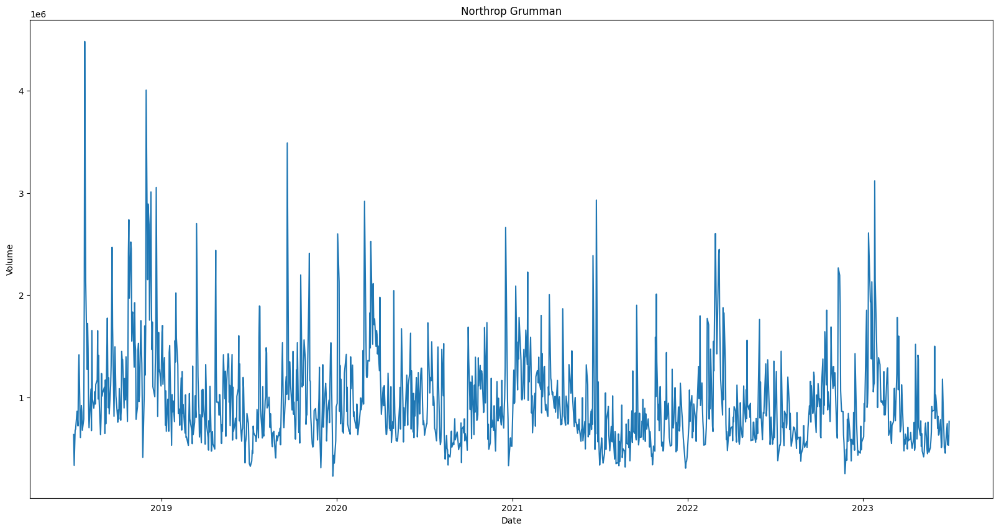

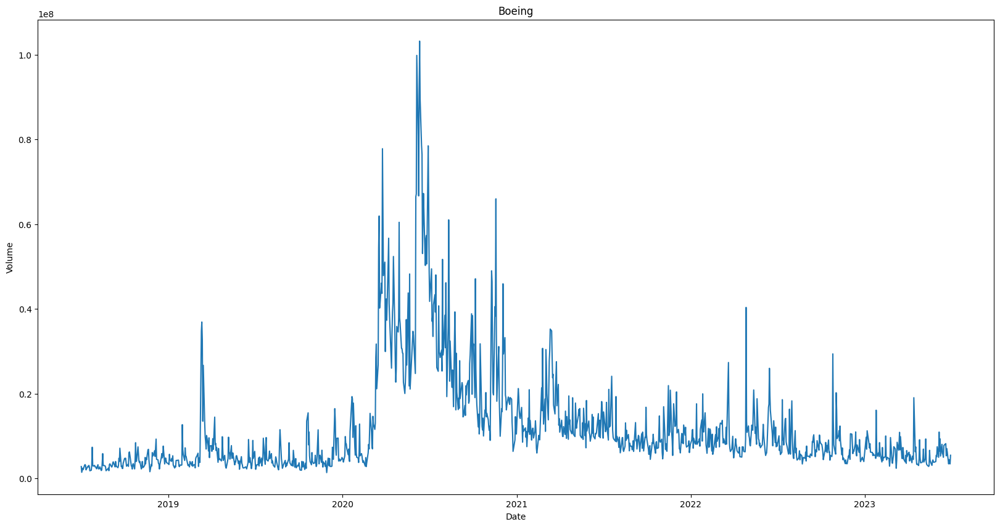

...

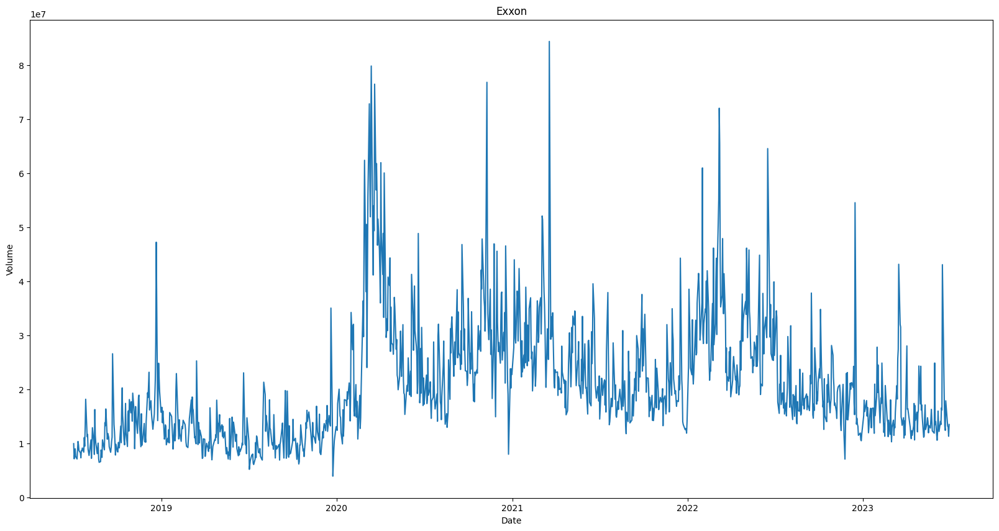

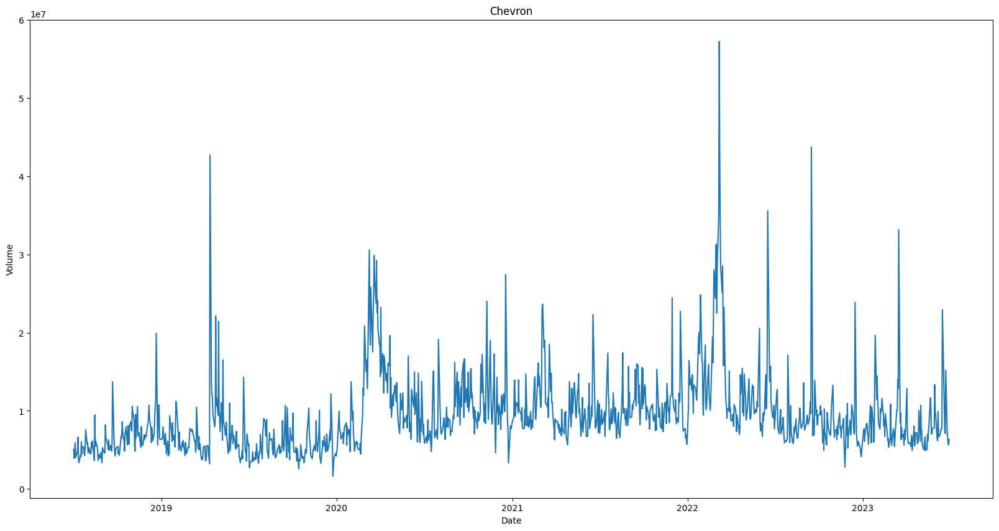

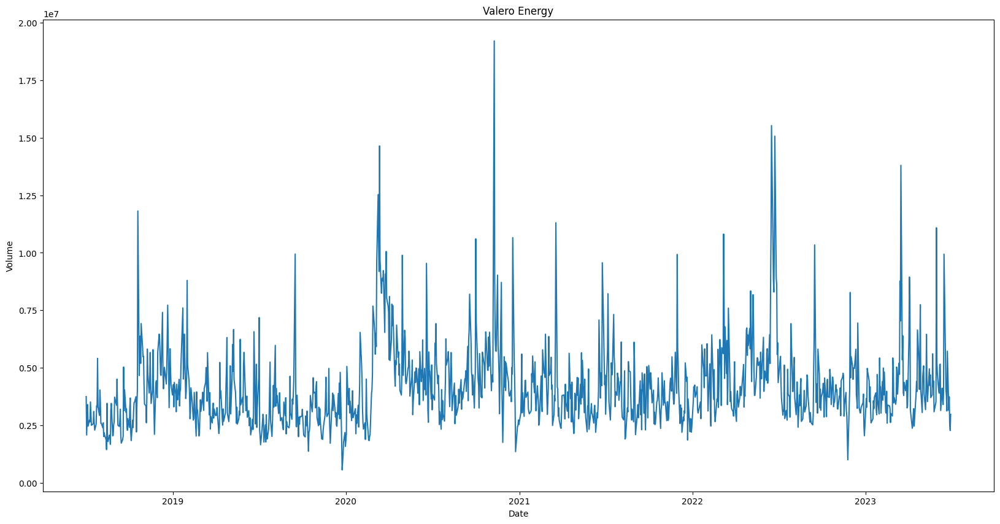

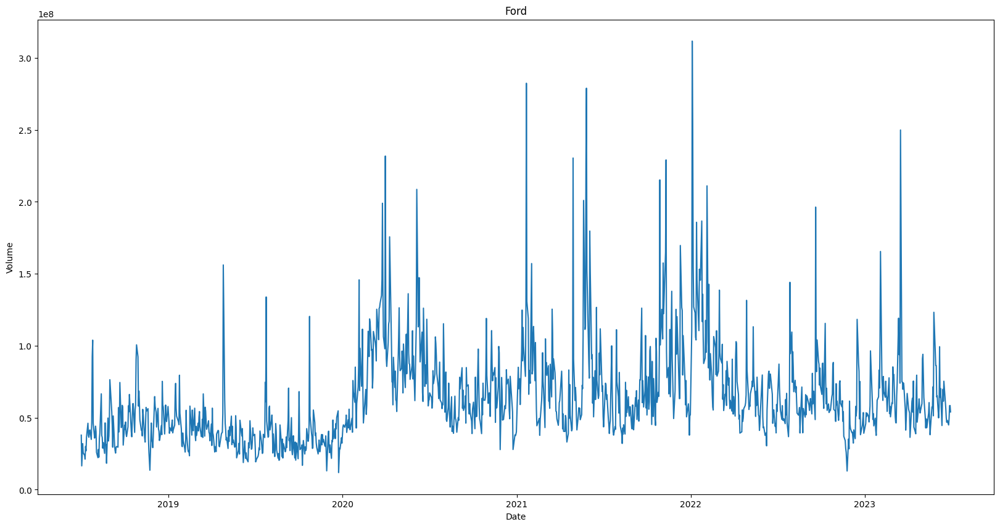

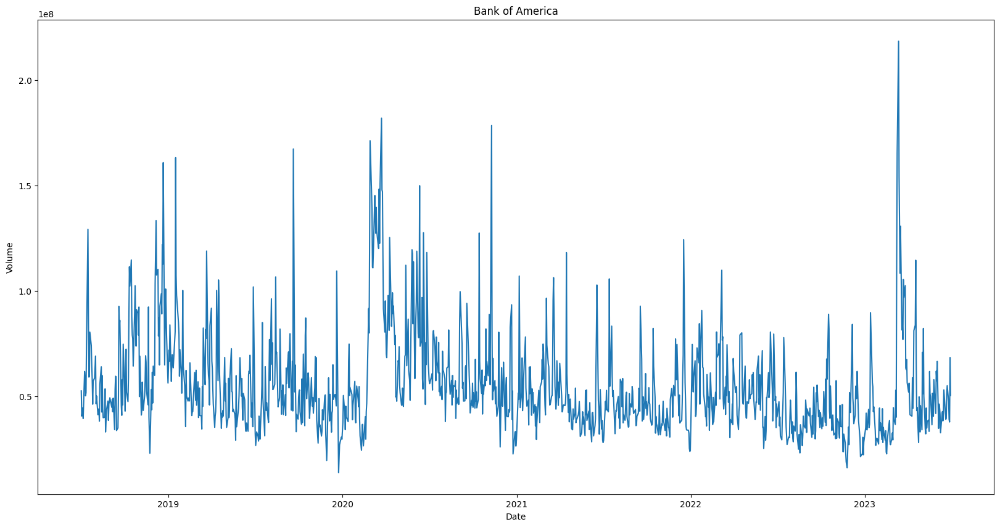

In [20]:
## Volume of stock traded
for i,j in companies_dict.items():
  plt.figure(figsize=(20,10))
  plt.title(i)
  plt.xlabel("Date")
  plt.ylabel("Volume")
  plt.plot(df['Volume'][j])

## Normalization
Rate of change of Stock Prices are having different scales, therefore we need to normalize our data in order to have consistency for further analysis

In [21]:
from sklearn.preprocessing import Normalizer
normalizer=Normalizer()
norm_movements=normalizer.fit_transform(movements_1)

In [22]:
norm_movements

array([[ 0.08534713,  0.15789297,  0.16256652, ..., -0.06807461,
         0.14732613, -0.01320826],
       [-0.1260322 , -0.195399  , -0.19149118, ..., -0.28528286,
        -0.08988386, -0.04429096],
       [ 0.00611131, -0.04932609,  0.03142978, ..., -0.28635961,
         0.21476971, -0.04889047],
       ...,
       [ 0.11585157,  0.00877578,  0.22117033, ...,  0.05529292,
         0.05002651,  0.09566513],
       [ 0.03367335, -0.05744357,  0.09904032, ...,  0.05084098,
        -0.03433388,  0.06866751],
       [ 0.27719986,  0.10543081, -0.00473948, ...,  0.09240086,
         0.00592299, -0.00829228]])

In [26]:
norm_movements_df=pd.DataFrame(norm_movements, columns=movements_1.columns,index = movements_1.index )

In [27]:
norm_movements_df

,AAPL,AMZN,AXP,BA,BAC,CVX,F,GD,GE,HMC,...,MSFT,NOC,PEP,RTX,TM,TSLA,TXN,VLO,WBA,XOM
Date,,,,,,,,,,,,,,,,,,,,,
2018-07-02,0.085347,0.157893,0.162567,0.547645,0.020321,-0.104652,0.008128,0.221496,-0.067113,0.014225,...,0.194064,0.246897,0.084332,0.074173,0.041658,-0.169340,0.132085,-0.068075,0.147326,-0.013208
2018-07-03,-0.126032,-0.195399,-0.191491,-0.683897,-0.071646,-0.095094,-0.014329,0.161531,0.015645,-0.022145,...,-0.186280,-0.139386,0.028659,-0.077881,-0.121147,-0.181417,-0.221452,-0.285283,-0.089884,-0.044291
2018-07-05,0.006111,-0.049326,0.031430,-0.518591,-0.005238,-0.371918,-0.008731,-0.123974,0.052426,0.012223,...,0.045399,-0.225248,0.111750,-0.106589,0.120481,-0.053547,0.291599,-0.286360,0.214770,-0.048890
2018-07-06,0.126818,0.145517,0.011935,0.358078,0.043765,0.123337,0.003979,0.053709,0.573389,-0.011936,...,0.252642,-0.001991,0.013925,0.068856,0.025862,0.052385,0.228770,0.208877,0.186994,0.073605
2018-07-09,0.027749,0.076925,0.066803,0.454258,0.084274,0.101745,0.010277,0.239460,0.006172,0.012333,...,0.020554,0.535449,-0.140798,0.043335,0.048303,0.044672,-0.134633,0.099689,0.062692,0.009250
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-06-26,-0.125154,-0.160454,-0.113923,-0.042520,0.023266,0.191743,0.008023,0.046532,0.073809,-0.016848,...,-0.410763,-0.125957,-0.101889,0.045730,-0.066589,-0.723650,0.020859,0.129968,0.023266,0.167675
2023-06-27,0.185379,0.046984,0.157187,0.280204,0.011960,0.002563,0.018794,-0.016232,0.024774,0.022211,...,0.231512,0.017087,0.132414,0.015377,0.157187,0.595434,0.553573,0.182816,0.006834,0.042714
2023-06-28,0.115852,0.008776,0.221170,-0.043006,-0.015798,0.129893,0.035106,-0.113217,0.154468,0.008776,...,0.104442,-0.538005,-0.223803,-0.045638,0.086889,0.573988,0.027209,0.055293,0.050027,0.095665


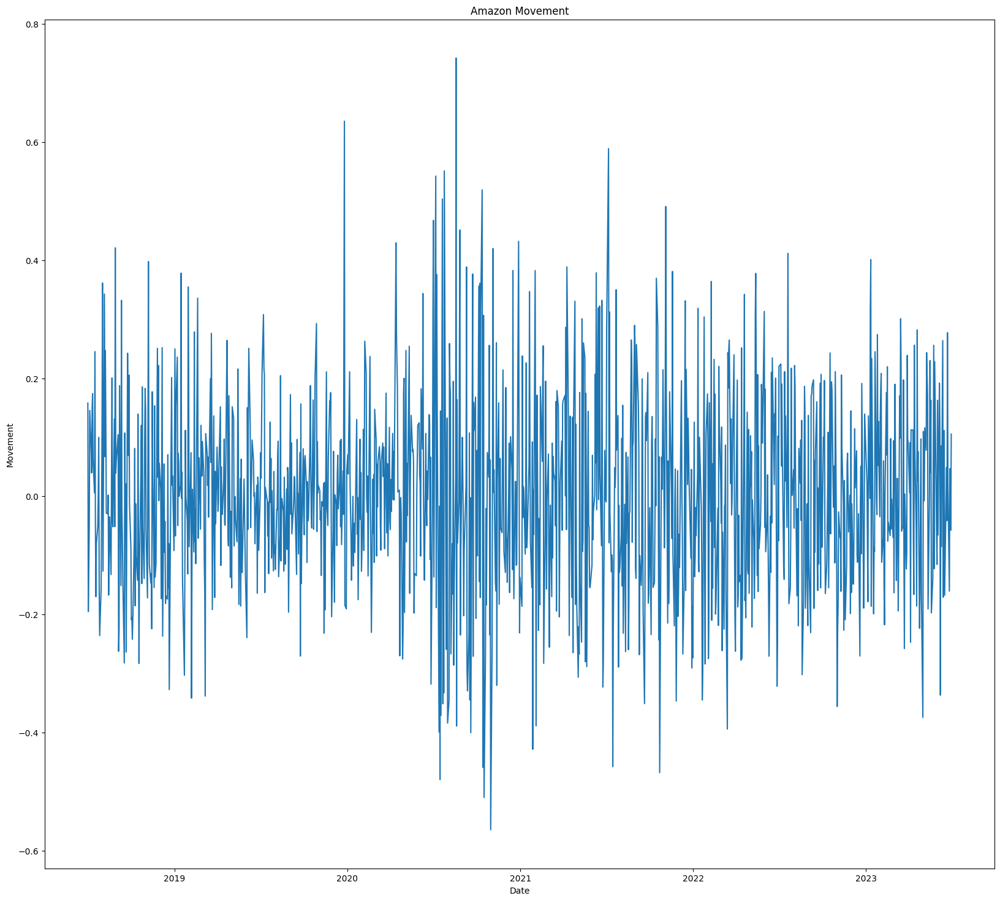

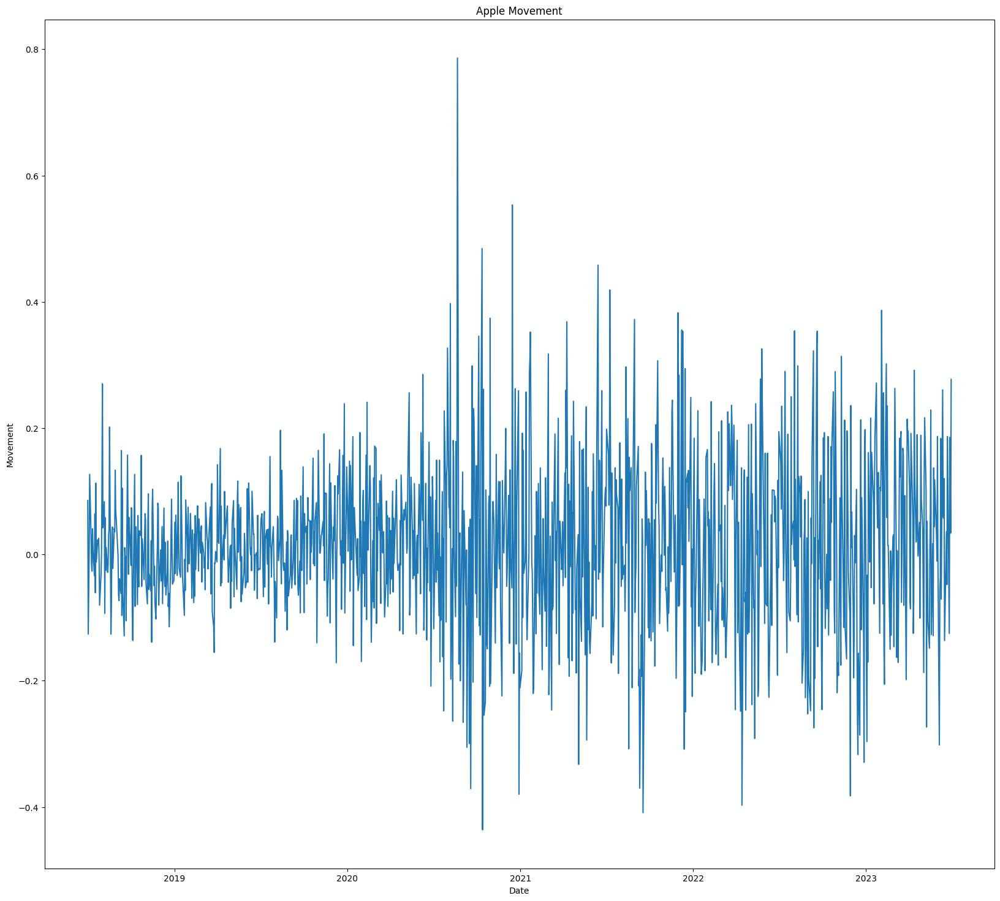

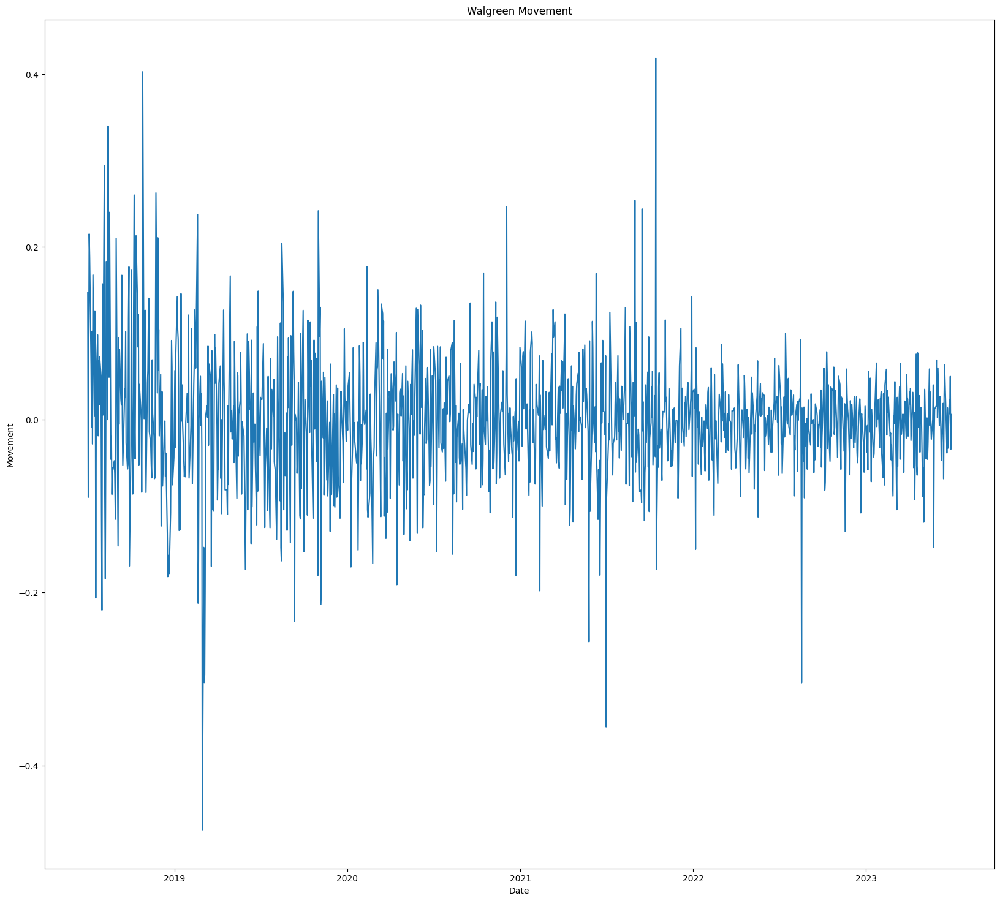

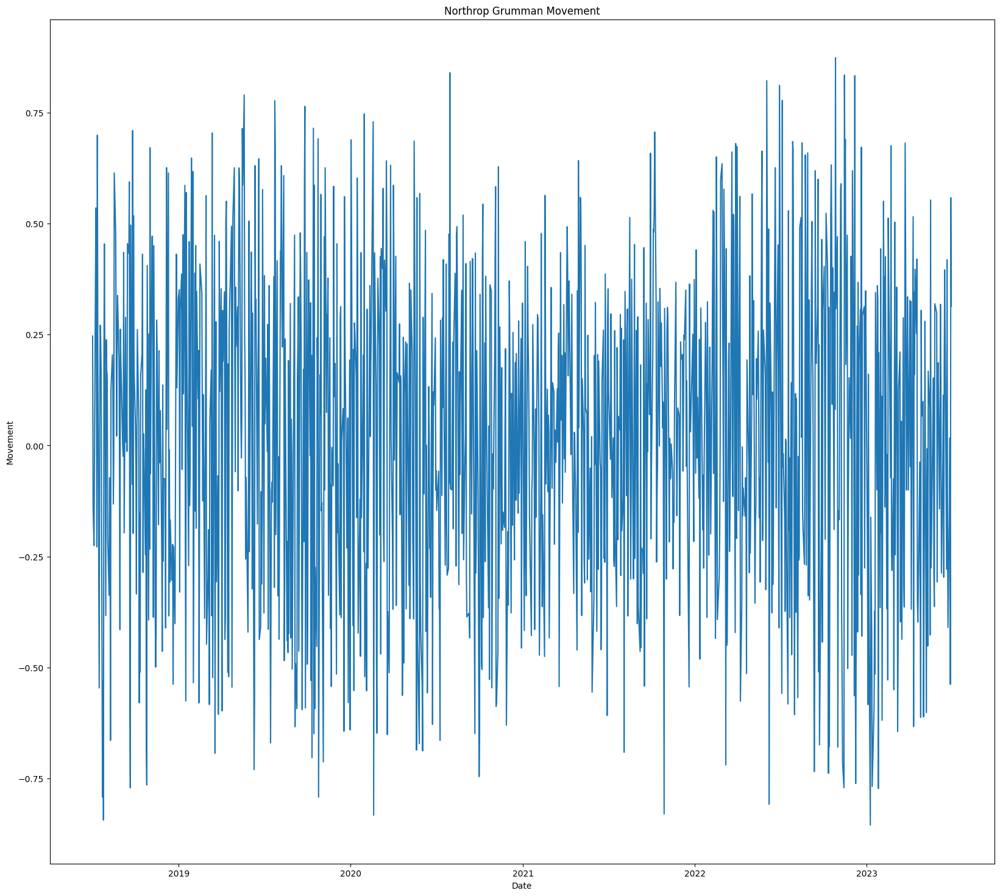

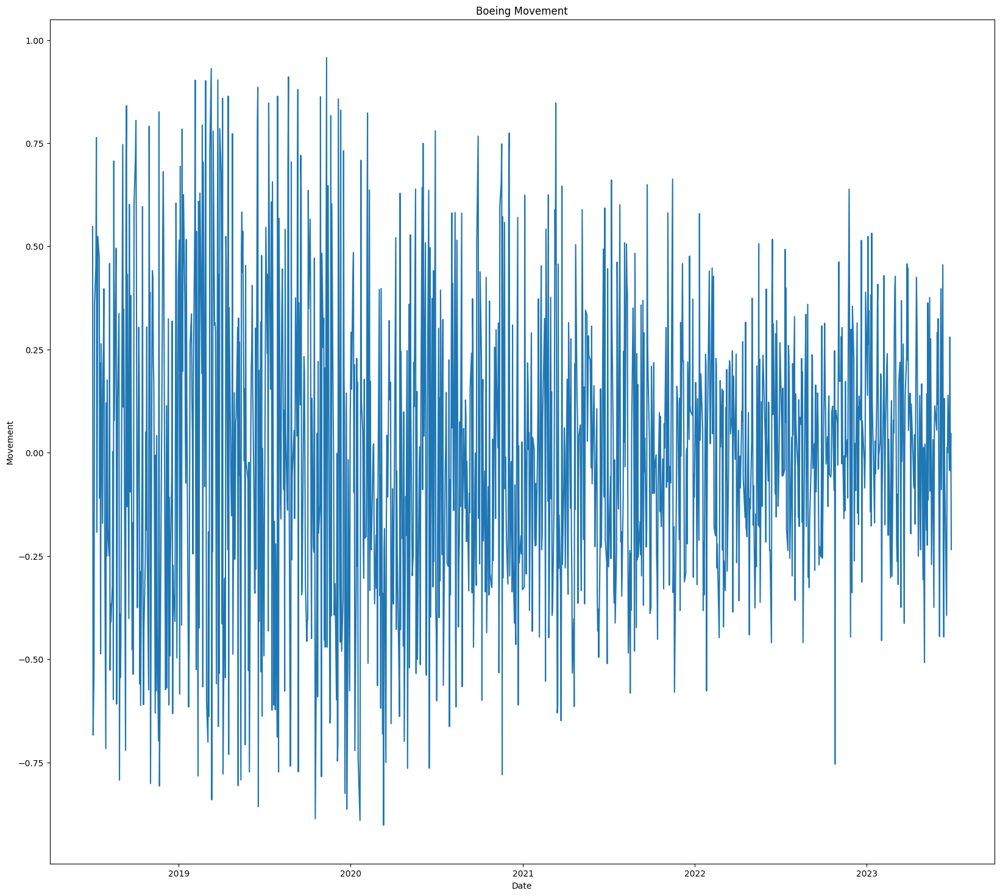

...

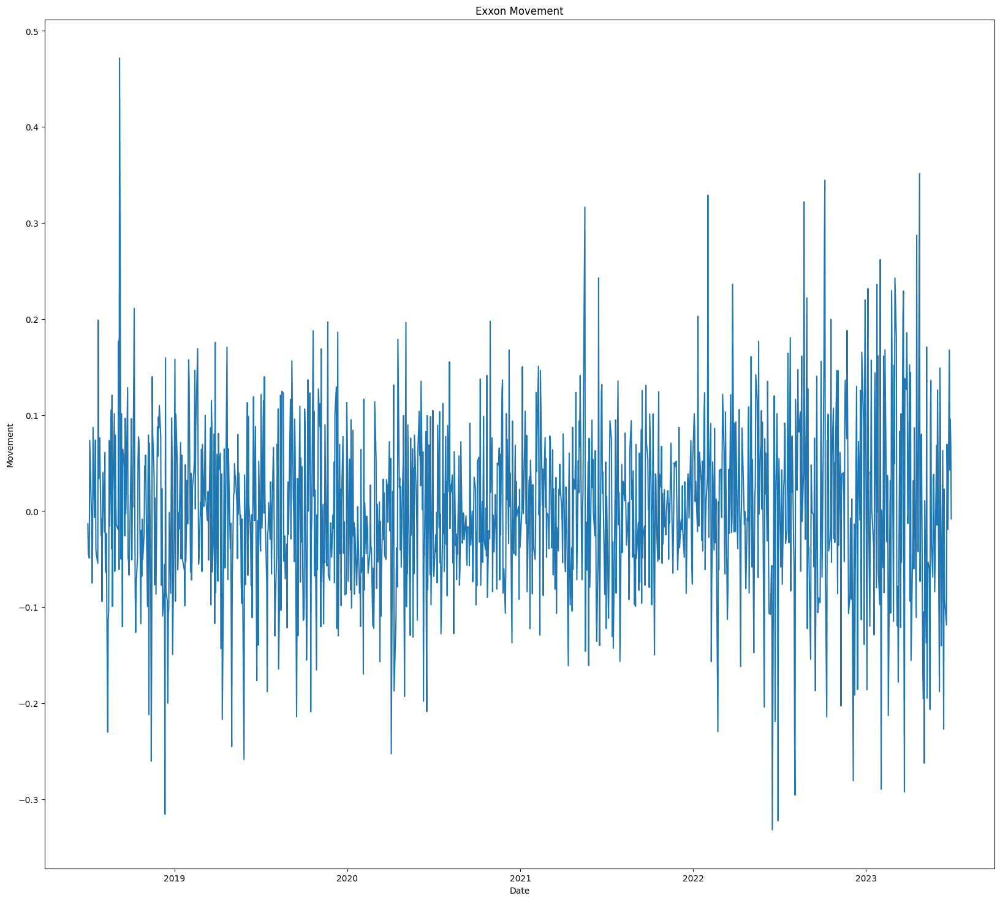

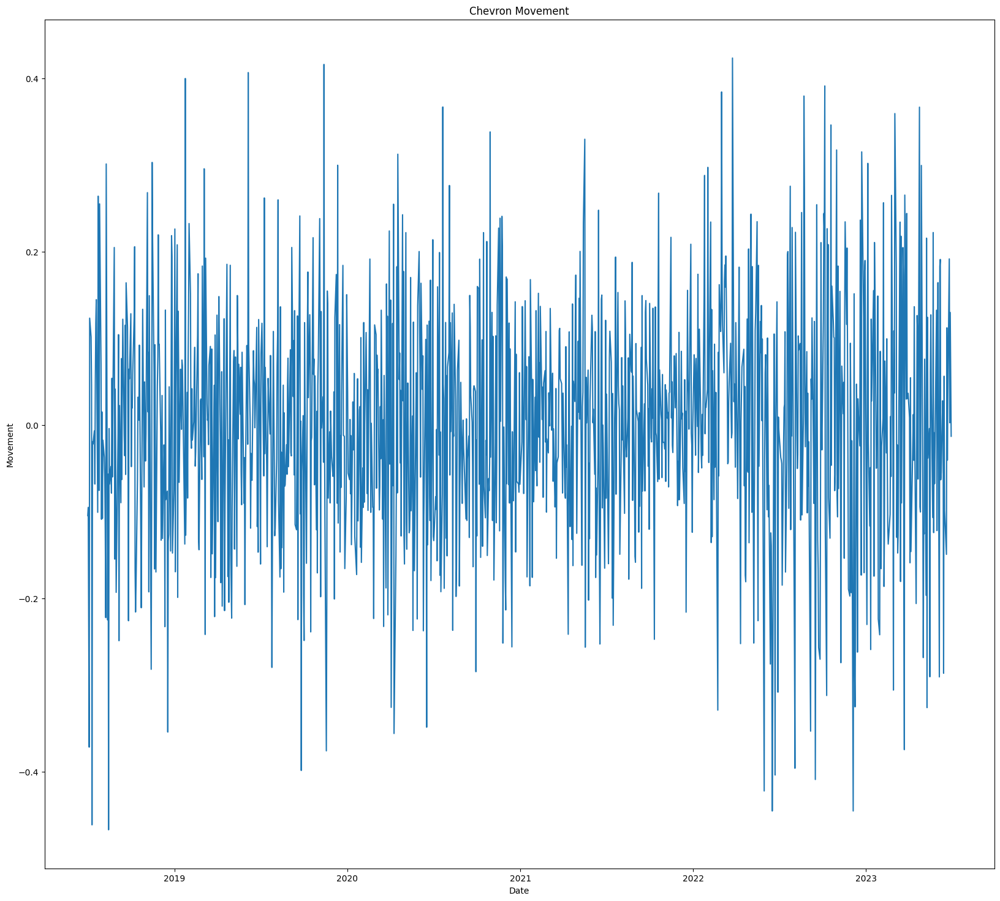

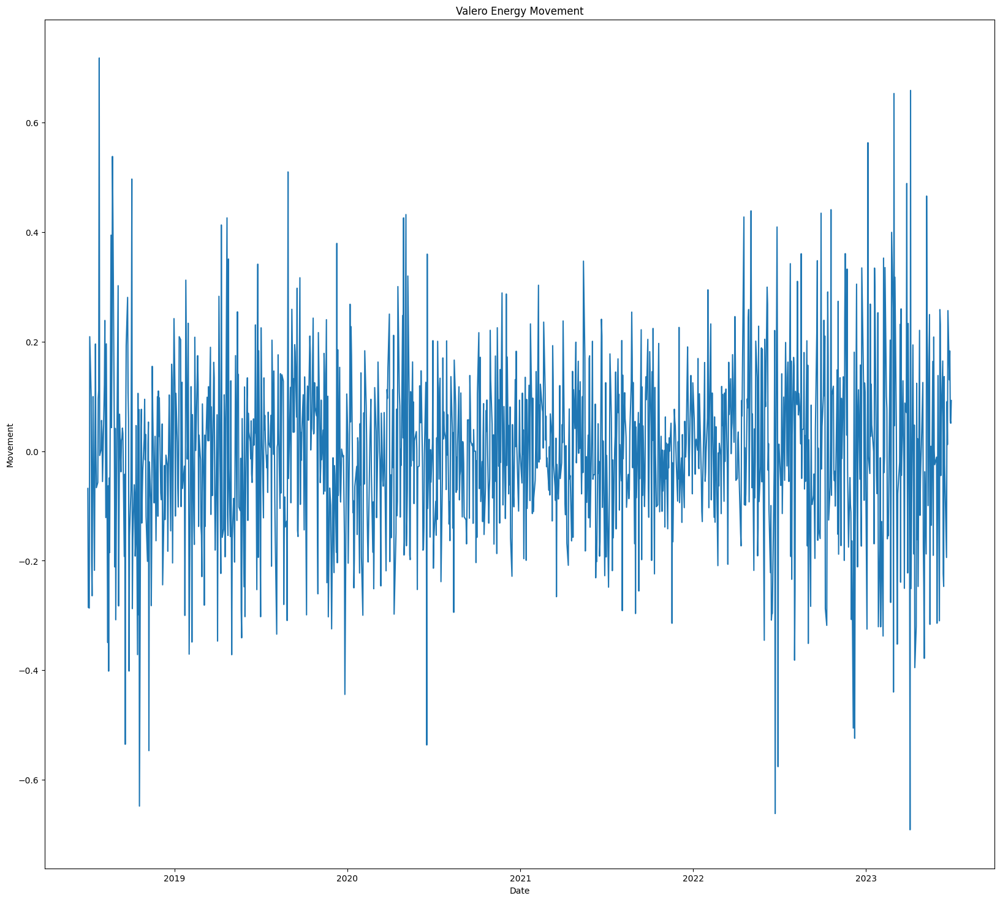

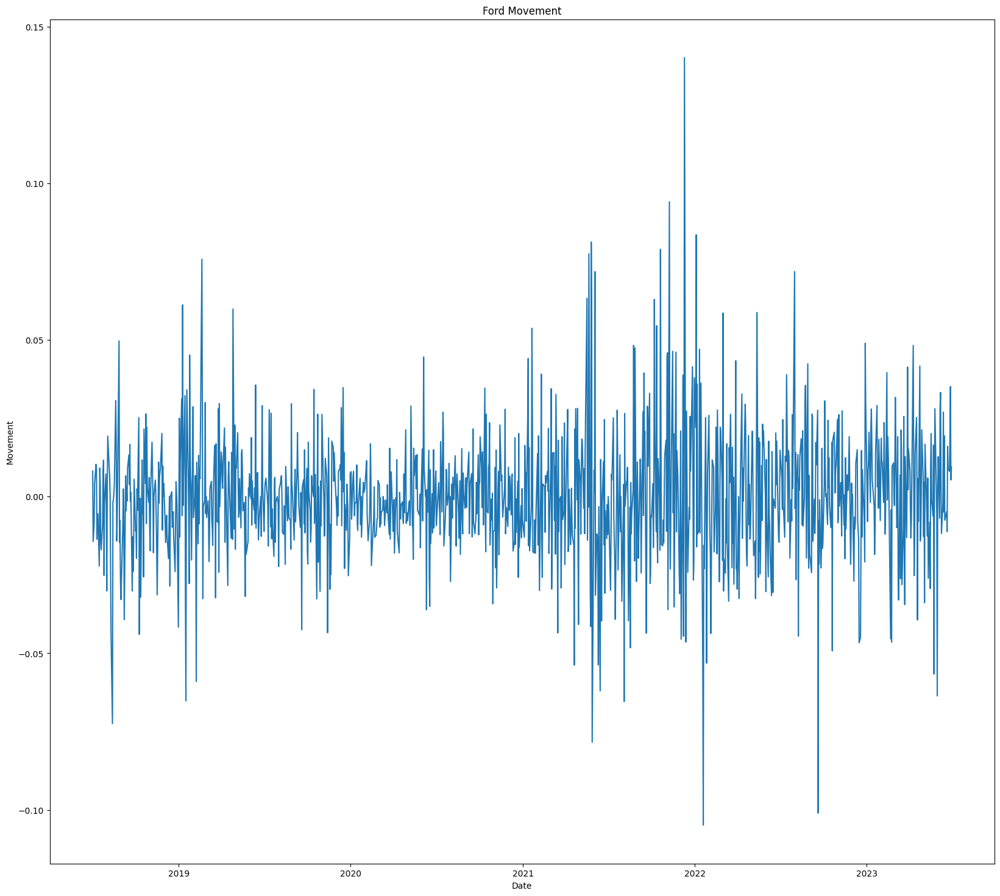

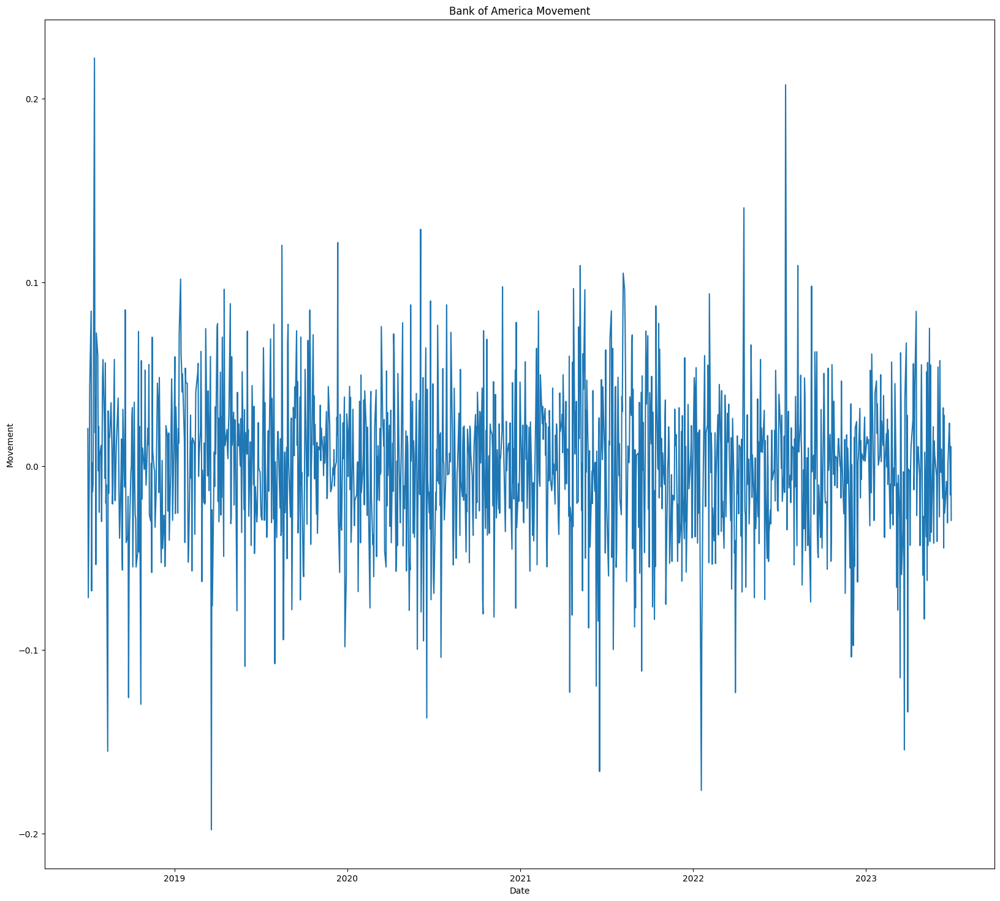

In [28]:
## Movements across various companies after normalization
for i,j in companies_dict.items():
  plt.figure(figsize=(20,18))
  plt.title(i + " Movement")
  plt.xlabel('Date')
  plt.ylabel('Movement')
  plt.plot(norm_movements_df[j])

## Making a Pipeline

In [30]:
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import Normalizer
from sklearn.cluster import KMeans

In [31]:
normalizer=Normalizer()

In [32]:
kmeans=KMeans(n_clusters=5, max_iter=1000, random_state=42)

In [33]:
## Making a pipleline combining our normalizer and KMeans
pipeline=make_pipeline(normalizer,kmeans)

In [34]:
## Fit Pipeline to daily stock movements created earlier
pipeline.fit(movements)

Pipeline(steps=[('normalizer', Normalizer()),
                ('kmeans',
                 KMeans(max_iter=1000, n_clusters=5, random_state=42))])

In [35]:
predictions=pipeline.predict(movements)

In [36]:
predictions

array([1, 1, 3, 3, 3, 0, 3, 2, 3, 3, 3, 1, 4, 4, 2, 2, 3, 4, 1, 2, 4, 2,
       3, 1, 1, 0, 3, 0], dtype=int32)

The companies and their respective classes are displayed below

In [37]:
df_1=pd.DataFrame({"Cluster":predictions,'Companies':list(companies_dict)})

In [38]:
df_1

,Cluster,Companies
0,1,Amazon
1,1,Apple
2,3,Walgreen
3,3,Northrop Grumman
4,3,Boeing
5,0,Lockheed Martin
6,3,McDonalds
7,2,Intel
8,3,Rayheon
9,3,IBM


## The Elbow Method

In [45]:
norm_data=normalizer.fit_transform(movements)

In [46]:
lst=[]
for i in range(1,11):
    kmodel=KMeans(n_clusters=i,n_init=15,max_iter=500)
    kmodel.fit(norm_data)
    lst.append(kmodel.inertia_)

In [47]:
lst

[17.94673775394569,
 15.765269057184067,
 13.886044001305322,
 12.526497444491726,
 11.063714261462604,
 10.314405961641343,
 9.491531123263622,
 8.681893785610917,
 8.058742999303302,
 7.295500521478164]

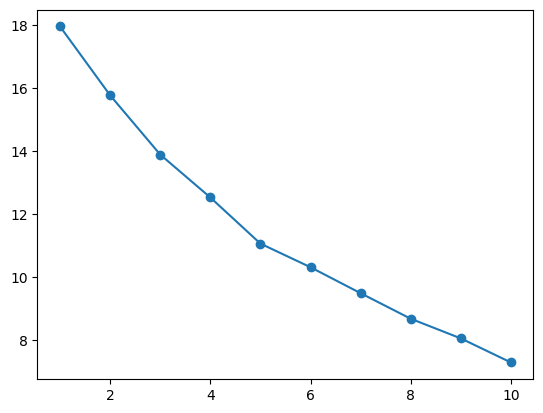

In [48]:
plt.plot(range(1,11),lst,marker='o')

We can see that 5 here is the best case scenario, hence we dont need to change our model

In [49]:
df_1[df_1['Cluster']==0]

,Cluster,Companies
5,0,Lockheed Martin
25,0,Valero Energy
27,0,Bank of America


In [50]:
df_1[df_1['Cluster']==1]

,Cluster,Companies
0,1,Amazon
1,1,Apple
11,1,MasterCard
18,1,Johnson & Johnson
23,1,Exxon
24,1,Chevron


In [51]:
df_1[df_1['Cluster']==2]

,Cluster,Companies
7,2,Intel
14,2,Tesla
15,2,American Express
19,2,Toyota
21,2,L3Harris


In [52]:
df_1[df_1['Cluster']==3]

,Cluster,Companies
2,3,Walgreen
3,3,Northrop Grumman
4,3,Boeing
6,3,McDonalds
8,3,Rayheon
9,3,IBM
10,3,Texas Instruments
16,3,Pepsi
22,3,General Dynamics
26,3,Ford


In [53]:
df_1[df_1['Cluster']==4]

,Cluster,Companies
12,4,Microsoft
13,4,General Electrics
17,4,Coca Cola
20,4,Honda


## PCA

In [66]:
from sklearn.decomposition import PCA
# Define a normalizer
normalizer = Normalizer()
# Reduce the data
reduced_data = PCA(n_components = 2)
# Create Kmeans model
kmeans = KMeans(n_clusters = 5,max_iter = 1000)
# Make a pipeline chaining normalizer, pca and kmeans
pipeline = make_pipeline(normalizer,reduced_data,kmeans)
# Fit pipeline to daily stock movements
pipeline.fit(movements)
# Prediction
predictions = pipeline.predict(movements)
# Create dataframe to store companies and predicted labels
df2 = pd.DataFrame({'labels':predictions,'companies':list(companies_dict.keys())}).sort_values(by=['labels'],axis = 0)

In [69]:
df2

,labels,companies
27,0,Bank of America
25,0,Valero Energy
5,0,Lockheed Martin
21,0,L3Harris
24,1,Chevron
23,1,Exxon
22,1,General Dynamics
18,1,Johnson & Johnson
16,1,Pepsi
11,1,MasterCard


<Figure size 640x480 with 0 Axes>

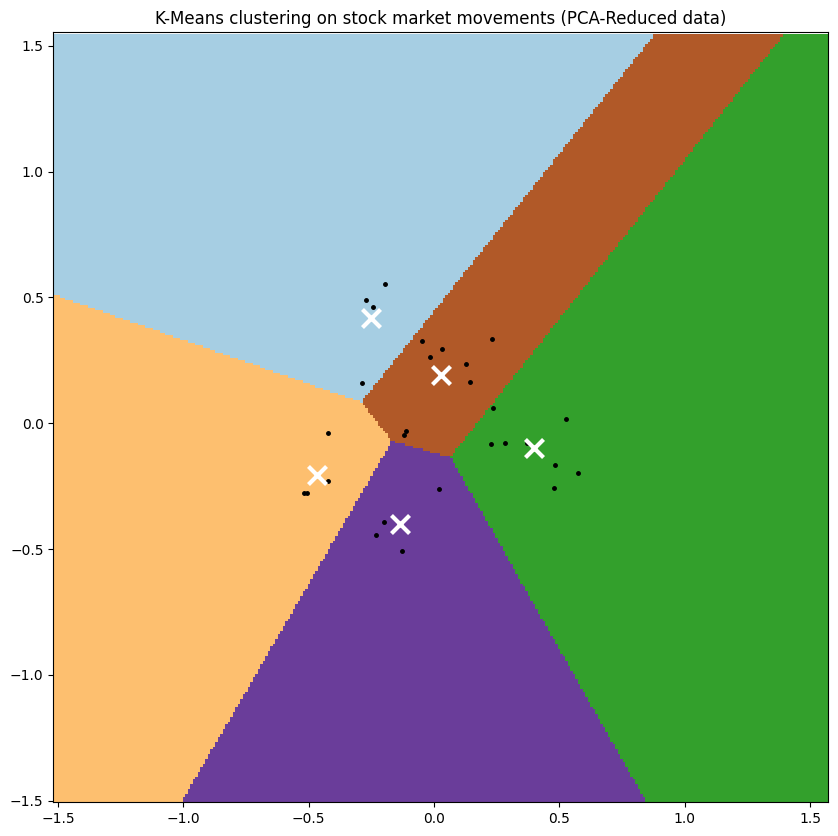

In [67]:
from sklearn.decomposition import PCA
# Reduce the data
reduced_data = PCA(n_components = 2).fit_transform(norm_data)
# Define step size of mesh
h = 0.01
# Plot the decision boundary
x_min,x_max = reduced_data[:,0].min()-1, reduced_data[:,0].max() + 1
y_min,y_max = reduced_data[:,1].min()-1, reduced_data[:,1].max() + 1
xx,yy = np.meshgrid(np.arange(x_min,x_max,h),np.arange(y_min,y_max,h))
# Obtain labels for each point in the mesh using our trained model
Z = kmeans.predict(np.c_[xx.ravel(),yy.ravel()])
# Put the result into a color plot
Z = Z.reshape(xx.shape)
# Define color plot
cmap = plt.cm.Paired
# Plotting figure
plt.clf()
plt.figure(figsize=(10,10))
plt.imshow(Z,interpolation = 'nearest',extent=(xx.min(),xx.max(),yy.min(),yy.max()),cmap = cmap,aspect = 'auto',origin = 'lower')
plt.plot(reduced_data[:,0],reduced_data[:,1],'k.',markersize = 5)
# Plot the centroid of each cluster as a white X
centroids = kmeans.cluster_centers_
plt.scatter(centroids[:,0],centroids[:,1],marker = 'x',s = 169,linewidths = 3,color = 'w',zorder = 10)
plt.title('K-Means clustering on stock market movements (PCA-Reduced data)')
plt.xlim(x_min,x_max)
plt.ylim(y_min,y_max)
plt.show()